# Using NFL Regular Season Data to Predict Playoff Success and Super Bowl Champion

By Anish Bagri

**Table of contents**<a id='toc0_'></a>    
1. [Introduction](#toc1_)    
1.1. [History of NFL Playoffs](#toc1_1_)    
1.2. [About this project](#toc1_2_)    
1.3. [Libraries and other imports used for the project](#toc1_3_)    
2. [Data Collection](#toc2_)    
2.1. [Scraping offense and defense data from NFL.com](#toc2_1_)    
2.2. [Scraping team record from Pro Football Reference](#toc2_2_)    
2.3. [Scraping Super Bowl winners from Topend Sports](#toc2_3_)    
3. [Data Processing](#toc3_)    
3.1. [Quick overview](#toc3_1_)    
3.2. [Variable declaration](#toc3_2_)    
3.3. [`make_stats` helper function](#toc3_3_)    
3.4. [`make_standings` helper function](#toc3_4_)    
3.5. [`make_sb` helper function](#toc3_5_)    
3.6. [Merging all the data together](#toc3_6_)    
3.7. [Super Bowl winner and runner-up value column](#toc3_7_)    
3.8. [Moving `Years` to the front](#toc3_8_)    
3.9. [Fixing the `Ties` column](#toc3_9_)    
3.10. [Remedying the `- Lng` columns](#toc3_10_)    
3.11. [Converting the other object columns to strings](#toc3_11_)    
3.12. [Tidy data](#toc3_12_)    
4. [Exploratory Data Analysis + Visualization](#toc4_)    
4.1. [Analyzing all stats](#toc4_1_)    
4.1.1. [Standings data](#toc4_1_1_)    
4.1.2. [Offense Stats](#toc4_1_2_)    
4.1.3. [Defense Stats](#toc4_1_3_)    
4.2. [Plotting stats against win-loss percentage](#toc4_2_)    
4.2.1. [Helper function: `plot_stats`](#toc4_2_1_)    
4.2.2. [Linear regression plots](#toc4_2_2_)    
4.3. [Analyzing playoff and Super Bowl teams](#toc4_3_)    
4.3.1. [Creating `sb_df`](#toc4_3_1_)    
4.3.2. [Playoff teams visualizations](#toc4_3_2_)    
4.3.3. [Just the Super Bowl winners](#toc4_3_3_)    
5. [Modeling: Hypothesis Testing, Machine Learning, and Analysis](#toc5_)    
5.1. [Defining the problem](#toc5_1_)    
5.1.1. [ML classification or regression?](#toc5_1_1_)    
5.1.2. [Creating model input (`x`) and output (`y`)](#toc5_1_2_)    
5.1.3. [Separating numerical and categorical columns](#toc5_1_3_)    
5.1.4. [80/20 training testing split](#toc5_1_4_)    
5.2. [Preprocessing](#toc5_2_)    
5.2.1. [One hot encoding](#toc5_2_1_)    
5.2.2. [Normalization](#toc5_2_2_)    
5.2.3. [Using ColumnTransformer to combine both preprocessor steps](#toc5_2_3_)    
5.3. [Feature selection/dimensionality reduction](#toc5_3_)    
5.4. [Model selection, training, and evaluation](#toc5_4_)    
5.4.1. [Model selection](#toc5_4_1_)    
5.4.2. [Model training](#toc5_4_2_)    
5.4.3. [Model evaluation](#toc5_4_3_)    
5.4.4. [Predicting the Super Bowl Winner for the 2022 Regular Season](#toc5_4_4_)    
6. [Interpretation: Insight and Policy Decision](#toc6_)    

<!-- vscode-jupyter-toc-config
	numbering=true
	anchor=true
	flat=true
	minLevel=2
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

## 1. <a id='toc1_'></a>[Introduction](#toc0_)

### 1.1. <a id='toc1_1_'></a>[History of NFL Playoffs](#toc0_)

[The National Football League (NFL)](https://www.nfl.com/) is a professional sports league for American football consisting of 32 teams, split evenly between the National Football Conference (NFC) and American Football Conference (AFC). Each conference is currently split into 4 divisions (North, South, East, West), each with 4 teams in it. For more information on the NFL and for different football terms, [check out the NFL page](https://operations.nfl.com/learn-the-game/nfl-basics/terms-glossary/). [The NFL playoffs have expanded and changed quite a lot over the years](https://www.chicagobears.com/news/history-of-how-nfl-playoffs-have-expanded), but here's a brief overview.

Starting in 1967, the top team in the AFC (formerly the AFL) and NFC (formerly the NFL) faced off against each other in the Super Bowl. Each league started off with just 2 divisions, and the winners of each division made it to the playoffs, meaning 4 teams made it to the playoffs. The winner of each division playoff game would become the conference champion (either AFL or NFL) and would face the other conference champion in the Super Bowl.

When the NFL and AFL merged in 1970, the league expanded to 3 divisions for each conference (NFC and AFC), so each of the division winners and a wildcard team (i.e. the team with the best record after the division winners) made the playoffs. The wildcard would play the #1 seed, totaling 8 teams in the playoffs. The winner of that would then face the winner of the #2 and #3 seed, and the winner of that would be the conference champion (now either NFC or AFC). Each conference champion then faced each other in the Super Bowl.

In 1978, a second wildcard was added to each conference, where the wildcard teams would face each other in the wildcard round. The winner would then face the highest seeded division winner. The rest of the pairings are the same as the 1970 playoff rules. This made it so that 10 teams made the playoffs.

In 1990, a third wildcard was added to each conference. The division champions were labeled from 1 to 3 in terms of their standings, and the wildcard teams were labeled from 4 to 6 by their standings. In the wildcard round, the #3 and #6 seeds and the #4 and #5 seeds would face one another while the #1 and #2 seeds received a first-round bye. The lowest seed that won would then face the #1 seed, and the higher seeded team would face the #2 seed. The winner of each of those match-ups would then face each other to determine the conference champion. Then, each conference champion would face off against each other in the Super Bowl. The higher seed would be guaranteed a home playoff game. This made it so that 12 teams made the playoffs.

In 2002, the league expanded to 4 divisions per conference, so there were now 4 division champions and 2 wildcard teams per conference. However, the same system was more or less kept in place until 2020.

In 2020, a third wildcard team was added to each conference. The #1 seed is the only one given a first-round bye, meaning that the #2 and #7 seeds, the #3 and #6 seeds, and the #4 and #5 seeds all face each other in the wildcard round. The division winners would be guaranteed homefield advantage for their first playoff game, but the highest seed between two pairings always gets homefield advantage. After the wildcard round, 3 teams are eliminated, leaving only 4. The #1 seed, after resting during the first-round bye, would then pair up against the lowest remaining seed, and the 2 teams remaining then face off against one another. The winners of each of those games then face off against each other, and the winner is the conference champion. As you know by now, each conference champion then faces off against the other in the Super Bowl. Currently, 14 teams make the playoffs each year.

### 1.2. <a id='toc1_2_'></a>[About this project](#toc0_)

As seen above, the playoffs have changed quite a lot over the years. Due to this massive shift, I will be limiting the dataset from 2002 onwards. This is the modern incarnation of the NFL playoffs as we know them today, and is also the most relevant in trying to predict the trajectory of modern-day teams. In addition, there were so many changes to several teams between 1990 and 2002 that it didn't make sense to lump them together in the same groups. From 2002 onwards, all 32 of the teams in the league fully exist, and the only thing that changed were some relocations; however, the team divisions and conferences that each team belongs to has remained constant, which saves me some headache when trying to classify all these teams.

For this project, I want to try and analyze the various playoff and championship teams to predict which teams have the best shot at the championship for each year. We will try to predict which teams will make the playoffs, how many rounds they're predicted to win, and attempt to see which team will be hailed as that year's Super Bowl champion. We'll use data starting from the 2002-03 season up until the 2021-22 season, and we'll only use the regular season data of the 2022-23 season. We'll then see how close this model gets to predicting the playoff wins and Super Bowl winner of the 2022-23 season.

### 1.3. <a id='toc1_3_'></a>[Libraries and other imports used for the project](#toc0_)

Here's all the libraries we'll use for this project.

In [405]:
import numpy as np
import pandas as pd
import requests as requests
from bs4 import BeautifulSoup
from pathlib import Path
import re
import plotly.io as pio
import plotly.express as px
import plotly.graph_objs as go
import statsmodels.api as sm
import statsmodels.formula.api as smf
import plotly.graph_objs as go
import statsmodels as sm
import time
import os.path
import string
import math
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.metrics  import f1_score,accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_friedman1
from sklearn.feature_selection import RFECV
from sklearn.svm import SVR
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler # min-max scaling
from sklearn.preprocessing import StandardScaler # z-score scaling
from sklearn.preprocessing import Normalizer # L2/unit vector scaling
from sklearn.compose import ColumnTransformer
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import chi2
from sklearn.feature_selection import f_regression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV
import skops.io as sio
import skops
from joblib import load
from sklearn.metrics import accuracy_score
import warnings
from sklearn.exceptions import ConvergenceWarning
from sklearn.metrics import precision_score

pio.renderers.default = "notebook+plotly_mimetype+png+jpeg+svg+pdf"
warnings.filterwarnings("ignore", category=ConvergenceWarning)
pd.options.mode.chained_assignment = None  # default='warn'

## 2. <a id='toc2_'></a>[Data Collection](#toc0_)

### 2.1. <a id='toc2_1_'></a>[Scraping offense and defense data from NFL.com](#toc0_)

To start off, we need data for the offense and defense of each team from every season between 2002-03 and 2022-23. [All of this data can be found on NFL.com](https://www.nfl.com/stats/team-stats/offense/passing/2022/reg/all). Offense is broken up into 5 different tables (Passing, Rushing, Receiving, Scoring, Downs), while defense is broken up into 6 tables (Passing, Rushing, Scoring, Downs, Fumbles, Interceptions). We'll ignore special teams data since it isn't as relevant as offense and defense. This means that for each year, there will be 11 different tables of data. With 21 seasons of data at our disposal, that totals to 231 different tables of data that we'll have to keep track of initially.

We'll use BeautifulSoup to help us obtain the data. We'll do this by looping through each year, each stat, and alternating between offense and defense. Some defensive stats don't apply to offense, so we account for that so as to not cause an error when trying to request the web page. I also added a `Thread.sleep` call to avoid being rate-limited.

For now, we'll store the data in CSV files the first time around (the file will exist afterwards, so there's no need to run it again). It took an hour the first time I ran this, so we certainly don't want to have to wait that long each time.

In [406]:
headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/110.0.0.0 Safari/537.36',
}

off_def = ["offense", "defense"]
o_stats = ["passing", "rushing", "receiving", "scoring", "downs"]
d_stats = ["passing", "rushing", "scoring", "downs", "fumbles", "interceptions"]
stats = d_stats + ["receiving"]
years = list(range(2002, 2023)) # 2002 to 2022

for year in years:
    for stat in stats:
        for type in off_def:
            # Check if the type + stat combo exists before proceeding
            if type == "offense" and stat in o_stats or type == "defense" and stat in d_stats:
                csv_name = f'OFF+DEF Data/{year}_{type}_{stat}.csv'
                # Only run if file doesn't already exist
                if not os.path.exists(csv_name):
                    r = requests.get(f'https://www.nfl.com/stats/team-stats/{type}/{stat}/{year}/reg/all', headers=headers)
                    soup = BeautifulSoup(r.content, 'html.parser')
                    soup = soup.find('table')
                    data_df = pd.read_html(str(soup))[0]
                    data_df.to_csv(csv_name, index=False)
                    time.sleep(3.0)

### 2.2. <a id='toc2_2_'></a>[Scraping team record from Pro Football Reference](#toc0_)

One thing that the NFL data was missing was the regular season record of each team. This is obviously an important metric that we need for our model, so I had to scrape that data from Pro Football Reference. Once again, we'll loop through each year and each conference using BeautifulSoup to obtain our data. We're also storing this information in CSV files the first time around (again, the file will exist afterwards, so there's no need to run it again).

In [407]:
conferences = ["AFC", "NFC"]

for year in years:
    for conference in conferences:
        csv_name = f'Standings Data/{year}_standings_{conference}.csv'
        # Only run if file doesn't already exist
        if not os.path.exists(csv_name):
            r = requests.get(f'https://www.pro-football-reference.com/years/{year}/', headers=headers)
            soup = BeautifulSoup(r.content, 'html.parser')
            index = 0 if conference == 'AFC' else 1
            soup = soup.find_all('table')[index]
            data_df = pd.read_html(str(soup))[0]
            data_df.to_csv(csv_name, index=False)
            time.sleep(3.0)

### 2.3. <a id='toc2_3_'></a>[Scraping Super Bowl winners from Topend Sports](#toc0_)

We also needed the past Super Bowl winners for our model, so we found that information from Topend Sports. We just need to do one call since it's only one table that holds all the data.

In [408]:
csv_name = f'Super Bowl Winners/winners.csv'

if not os.path.exists(csv_name):
    r = requests.get('https://www.topendsports.com/events/super-bowl/winners-list.htm', headers=headers)
    soup = BeautifulSoup(r.content, 'html.parser')
    soup = soup.find('table')
    data_df = pd.read_html(str(soup))[0]
    data_df.to_csv(csv_name, index=False)

## 3. <a id='toc3_'></a>[Data Processing](#toc0_)

### 3.1. <a id='toc3_1_'></a>[Quick overview](#toc0_)

Now that we have all the data, it's time to merge them together into one big dataframe. The process is the following:

- We'll start by taking the data specific to each year (each of the offense/defense stats stored in `stats_df`, the standings stored in `standings_df`) and combining them together to form a dataframe for the year (`year_df`). Before we do that, however, we're going to have to rename some of the column names for the stats since there's too much overlap between them
- Then, we'll append that year specific dataframe, `year_df`, to the overall dataframe, `nfl_df`
- Finally, we can combine the Super Bowl data dataframe, `sb_df`, with `nfl_df` to form our complete dataframe

It may not seem like much, but there are a lot CSV files. For stats alone, there's 11 offensive and defensive stats per year, totaling to 11 * 21 = 231 files. For standings, there's 2 separate standings for each conference per year, totaling to 2 * 21 = 42 files. This, of course, is neglecting all the changes we have to make in the columns and the dataframes, of which there are a lot.

### 3.2. <a id='toc3_2_'></a>[Variable declaration](#toc0_)

Let's start with the easy part: defining some of the variables we need:
- `nfl_df` is our overall dataframe
- `o_d_dict` is a dictionary that shortens "offense" and "defense"
- `stat_dict` is a dictionary that shortens the various stats
- `team_dict` is a dictionary that maps the names of teams from the stats dataset to the standings dataset

`o_d_dict` and `stat_dict` will be used for changing the column names for `stats_df` since otherwise we'd have too much overlap between names.

In [409]:
# Overall df
nfl_df = pd.DataFrame()
# Dictionaries helping with renaming stats
o_d_dict = {'offense':'off', 'defense':'def'}
stat_dict = {'passing':'Pass ',
             'rushing':'Rush ',
             'receiving':'Rec ',
             'scoring':'Scor ',
             'downs':'Down ',
             'fumbles':'Fumb ',
             'interceptions':'Int '
             }
# Dictionary helping with mapping name of team from one dataset to the otherr
team_dict = {'CardinalsCardinals':'Arizona Cardinals',
             'FalconsFalcons':'Atlanta Falcons',
             'RavensRavens':'Baltimore Ravens',
             'BillsBills':'Buffalo Bills',
             'BearsBears':'Chicago Bears',
             'BengalsBengals':'Cincinnati Bengals',
             'BrownsBrowns':'Cleveland Browns',
             'CowboysCowboys':'Dallas Cowboys',
             'BroncosBroncos':'Denver Broncos',
             'LionsLions':'Detroit Lions',
             'PackersPackers':'Green Bay Packers',
             'ColtsColts':'Indianapolis Colts',
             'ChiefsChiefs':'Kansas City Chiefs',
             'RaidersRaidersLV':'Las Vegas Raiders',
             'ChargersChargersLA':'Los Angeles Chargers',
             'RamsRamsLA':'Los Angeles Rams',
             'RaidersRaiders':'Oakland Raiders',
             'DolphinsDolphins':'Miami Dolphins',
             'VikingsVikings':'Minnesota Vikings',
             'PatriotsPatriots':'New England Patriots',
             'SaintsSaints':'New Orleans Saints',
             'GiantsGiants':'New York Giants',
             'JetsJets':'New York Jets',
             'EaglesEagles':'Philadelphia Eagles',
             'SteelersSteelers':'Pittsburgh Steelers',
             'ChargersChargers':'San Diego Chargers',
             '49ers49ers':'San Francisco 49ers',
             'NinersNiners':'San Francisco 49ers',
             'SeahawksSeahawks':'Seattle Seahawks',
             'RamsRams':'St. Louis Rams',
             'BuccaneersBuccaneers':'Tampa Bay Buccaneers',
             'Football TeamFootball Team':'Washington Football Team',
             'CommandersCommanders':'Washington Commanders',
             'RedskinsRedskins':'Washington Redskins',
             'TexansTexans':'Houston Texans',
             'PanthersPanthers':'Carolina Panthers',
             'TitansTitans':'Tennessee Titans',
             'JaguarsJaguars':'Jacksonville Jaguars'
             }

### 3.3. <a id='toc3_3_'></a>[`make_stats` helper function](#toc0_)

Next, let's define a helper function for when we combine our various stats into `stats_df`. We'll pass in `stat_df`, the `year`, the `type` of "fense" we're looking at (offense vs defense), and the `stat`. Here's what our function will do:

- Since offense and defense have different stats associated with them, we need to check if the pairings of `type` and `stat` match up. If they do, that's when we make a call to its corresponding CSV file for the `year`
- Once we've confirmed the stat exists, we'll use `o_d_dict` and `stat_dict` to create a `prefix` we can add to all columns (except for `Team` since that's the column we'll be merging on). This will help us differentiate between the different stats, since many of them have the same name as other stats
- After that, we have to look at some specific teams, specifically the Rams, Chargers, and Raiders. These teams all relocated to different cities, so we have to make sure that we have the right team names for them. The St. Louis Rams became the Los Angeles Rams starting in 2016, the San Diego Chargers became the Los Angeles Chargers starting in 2017, and the Oakland Raiders became the Las Vegas Raiders starting in 2020. We'll add suffixes to each of these team names to reflect these changes, as this is how I've defined these entries in `team_dict`
- Now, we can merge all these values to `stats_df`, and this will hold all the stats for a certain year

In [410]:
def make_stats(stat_df, year, type, stat):

    # Check if the type + stat combo exists before proceeding
    if type == "offense" and stat in o_stats or type == "defense" and stat in d_stats:
        df = pd.read_csv(f'OFF+DEF Data/{year}_{type}_{stat}.csv')
        # Rename column stats
        prefix = o_d_dict[type] + stat_dict[stat]
        df = df.rename(columns = lambda col: f"{prefix}{col}" 
                            if col not in ('Team') 
                            else col
                )
        
        # Update team names to make it easier to merge with standings data
        # St Louis Rams relocated to Los Angeles in 2016, update to map to correct dict vals
        if year >= 2016:
            for idx, val in df['Team'].items():
                # San Diego Chargers relocated to Los Angeles in 2017
                if val == 'RamsRams' or (year >= 2017 and val == 'ChargersChargers'):
                    df['Team'][idx] += 'LA'
                # Oakland Raiders relocated to Las Vegas in 2020
                elif year >= 2020 and val == 'RaidersRaiders':
                    df['Team'][idx] += 'LV'

        # Merge all the dataframes for a year into year_df
        if stat_df is None or stat_df.empty:
            stat_df = pd.concat([stat_df, df], ignore_index=True)
        else:
            stat_df = stat_df.merge(df, on="Team", how='outer')

    return stat_df

### 3.4. <a id='toc3_4_'></a>[`make_standings` helper function](#toc0_)

Now, let's move on to the standings. We'll also create a helper function for this that takes in `standing_df`, as well as the `year` and `conference` we're looking at (either AFC or NFC). This function will:

- Read in the CSV file associated with the `year` and the record of the `conference` at large
- Specify which `conference` a team is in (will be helpful in overall dataframe `nfl_df`)
- Determine which teams made the playoffs that year (specified by either '*' meaning Conference Division Winner or '+' meaning Wildcard)
- Rename the `Tm` column so that we can merge the `stat_df` with it
- Get rid of characters like '*' and '+' to make sure the team name we're merging on is consistent
- Merge `standing_df` with all this data so that it holds both AFC and NFC standings for a particular year

In [411]:
def make_standings(standings_df, year, conference):

    # Read in file
    df = pd.read_csv(f'Standings Data/{year}_standings_{conference}.csv')

    # Specify conference
    df['Conference'] = conference

    # Determine which teams made playoffs based off if they have '+' or '*' after their name
    df.rename(columns={'Tm':'Team'}, inplace=True)
    df['Made Playoffs'] = False
    for idx, val in (df['Team']).items():
        if val.find('+') >= 0 or val.find('*') >= 0:
            df['Made Playoffs'][idx] = True

    # Remove '+' and '*' from `Team`
    df['Team'] = df['Team'].str.replace('+', '', regex=False)
    df['Team'] = df['Team'].str.replace('*', '', regex=False)

    # Merge standings_df
    if standings_df is None or standings_df.empty:
        standings_df = df
    else:
        standings_df = pd.concat([standings_df, df])

    return standings_df

### 3.5. <a id='toc3_5_'></a>[`make_sb` helper function](#toc0_)

At this point (in our main code, outside these helpers), we have all the stats and standings data stored in `nfl_df`. However, we also want to know who won the Super Bowl for a given year (as well as the runner-up), so we have to create `sb_df` (which holds the Super Bowl data). We'll create a helper for this that will take in sb_df and:

- Read in the Superbowl Winners CSV file
- Decrement `Year` by 1. The regular season occurs in year x, but the Super Bowl takes place in year x+1. However, the winner of the Super Bowl in year x+1 wins the Super Bowl for the season starting in x. For instance, the New York Giants won the Super Bowl in 2008 for the 2007 season, so we would say the Super Bowl winner for the 2007 season was the New York Giants ([Eli Manning is Tom Brady's kryptonite](https://www.statmuse.com/nfl/ask/eli-manning-record-against-tom-brady-in-superbowls)). We must account for this if we want to join the values together
- Drop all columns except for `Year`, `Winner`, and `Opposition` since those are the only relevant ones. We will also rename `Winner` to `SB Winner` and `Opposition` to `SB Runner-Up`

Once this is all done, we can merge `nfl_df` with `sb_df`.

In [412]:
def make_sb(sb_df):
    # Super Bowl for 2022 season is held in 2023, need to subtract to align both of these
    sb_df['Year'] -= 1
    sb_df = sb_df.drop(columns=['No.', 'Score', 'Venue'])
    # Only need data from 2002 onwards
    sb_df = sb_df[:21].copy(deep=True)
    sb_df.rename(columns={'Opposition':'Runner-Up'}, inplace=True)
    sb_df = sb_df.rename(columns = lambda col: f'SB {col}' 
                                        if col not in ('Year') 
                                        else col
                            )
    
    return sb_df

### 3.6. <a id='toc3_6_'></a>[Merging all the data together](#toc0_)

Now that we have all of our helpers, we can actually merge the data together to create `nfl_df`. We will be:

- Looping through `year`, `stats`, and `type` and calling `make_stats` to construct `stat_df`
- Renaming the `Team` names in `stat_df` using `team_dict` to make merging with standings data easier
- Merging `year_df` with `stat_df` after the function call
- Looping through `year` and `conference` and calling `make_standings` to construct `standings_df`
- Merging `year_df` with `standings_df` after the function call
- Appending `year_df` to `nfl_df` since we're done with this `year` and will be moving on to the next year
- Calling `make_sb` to construct `sb_df` outside of the loops
- Doing one final merge between `nfl_df` and `sb_df`

And just like that, we've created the dataframe we'll be working with for the rest of this project.

In [413]:
for year in years:
    year_df = pd.DataFrame()

    # Combine all offensive + defensive stats together
    stat_df = pd.DataFrame()
    for stat in stats:
        for type in off_def:
            stat_df = make_stats(stat_df, year, type, stat)

    # Rename team names to make it easier to merge with standings data
    stat_df['Team'].replace(team_dict, inplace=True)
    year_df = stat_df.copy(deep=True)

    # Combine standings data together
    standings_df = pd.DataFrame()
    for conference in conferences:
        standings_df = make_standings(standings_df, year, conference)

    # Merge year and standings df w/ one another
    year_df = standings_df.merge(year_df, on='Team', how='outer')
    year_df['Year'] = year

    # Add year_df onto bottom of nfl_df
    nfl_df = pd.concat([nfl_df, year_df], ignore_index=True)

# Create Super Bowl data and merge with nfl_df
sb_df = pd.read_csv(f'Super Bowl Winners/winners.csv')
sb_df = make_sb(sb_df)
nfl_df = nfl_df.merge(sb_df, on='Year', how='outer')

nfl_df

,Team,W,L,T,W-L%,PF,PA,PD,MoV,SoS,...,offRec TD,offRec 20+,offRec 40+,offRec Lng,offRec Rec 1st,offRec Rec 1st%,offRec Rec FUM,Year,SB Winner,SB Runner-Up
0,New York Jets,9,7,0.0,0.563,359,336,23,1.4,1.7,...,25,44,3,47T,190,57.8,4,2002,Tampa Bay Buccaneers,Oakland Raiders
1,New England Patriots,9,7,0.0,0.563,381,346,35,2.2,1.8,...,28,37,3,49,184,49.2,5,2002,Tampa Bay Buccaneers,Oakland Raiders
2,Miami Dolphins,9,7,0.0,0.563,378,301,77,4.8,1.2,...,18,38,5,77T,155,57.2,6,2002,Tampa Bay Buccaneers,Oakland Raiders
3,Buffalo Bills,8,8,0.0,0.500,379,397,-18,-1.1,0.9,...,24,45,13,73,218,57.8,4,2002,Tampa Bay Buccaneers,Oakland Raiders
4,Pittsburgh Steelers,10,5,1.0,0.656,390,345,45,2.8,-0.1,...,26,51,8,72,199,56.9,6,2002,Tampa Bay Buccaneers,Oakland Raiders
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,Atlanta Falcons,7,10,0.0,0.412,365,386,-21,-1.2,-0.9,...,17,37,5,75T,148,57.6,4,2022,Kansas City Chiefs,Philadelphia Eagles
668,San Francisco 49ers,13,4,0.0,0.765,450,277,173,10.2,-2.3,...,30,56,6,57,188,55.6,4,2022,Kansas City Chiefs,Philadelphia Eagles
669,Seattle Seahawks,9,8,0.0,0.529,407,401,6,0.4,-0.8,...,30,50,6,54,206,51.6,4,2022,Kansas City Chiefs,Philadelphia Eagles
670,Los Angeles Rams,5,12,0.0,0.294,307,384,-77,-4.5,0.5,...,16,37,4,75,180,52.0,2,2022,Kansas City Chiefs,Philadelphia Eagles


### 3.7. <a id='toc3_7_'></a>[Super Bowl winner and runner-up value column](#toc0_)

Now that all our data is in order, it's time to add two more columns. We can use the `SB Winner` and `SB Runner-Up` columns to determine if a particular team from that year won the Super Bowl (`Won SB`) and/or made it (`Made SB`) and assign those values as True and False. This will make our lives easier down the line. We also don't need the `SB Winner` and `SB Runner-Up` columns anymore, so we can just drop them.

I'll show the first few values to prove that it worked.

In [414]:
nfl_df['Won SB'] = nfl_df.apply(lambda row: row['Team'] == row['SB Winner'], axis=1)
nfl_df['Lost SB'] = nfl_df.apply(lambda row: row['Team'] == row['SB Runner-Up'], axis=1)
nfl_df['Made SB'] = nfl_df.apply(lambda row: row['Team'] == row['SB Runner-Up'] or row['Won SB'], axis=1)
nfl_df = nfl_df.drop(columns={'SB Winner', 'SB Runner-Up'})

nfl_df[nfl_df['Made SB']].head(6)

,Team,W,L,T,W-L%,PF,PA,PD,MoV,SoS,...,offRec 20+,offRec 40+,offRec Lng,offRec Rec 1st,offRec Rec 1st%,offRec Rec FUM,Year,Won SB,Lost SB,Made SB
12,Oakland Raiders,11,5,0.0,0.688,450,304,146,9.1,1.5,...,48,8,75T,226,54.1,4,2002,False,True,True
24,Tampa Bay Buccaneers,12,4,0.0,0.750,346,196,150,9.4,-0.6,...,37,6,76,172,49.4,5,2002,True,False,True
32,New England Patriots,14,2,NaN,0.875,348,238,110,6.9,0.1,...,44,8,82,177,55.3,3,2003,True,False,True
56,Carolina Panthers,11,5,NaN,0.688,325,304,21,1.3,-2.2,...,46,8,67,146,54.1,7,2003,False,True,True
64,New England Patriots,14,2,NaN,0.875,437,260,177,11.1,1.8,...,53,10,50,193,65.9,4,2004,True,False,True
80,Philadelphia Eagles,13,3,NaN,0.813,386,260,126,7.9,-2.3,...,56,20,80T,188,56.0,4,2004,False,True,True


### 3.8. <a id='toc3_8_'></a>[Moving `Years` to the front](#toc0_)

This won't change the data or anything, but it does make it easier to determine which iteration of the team we're looking at. Originally, I wanted to combine both `Team` and `Year` into 1 column. However, for the machine learning part of the project, it would be a hassle to have to use both or separate the combined column back into their orignal components. It just makes sense to have them be separate columns, while also moving `Year` up for our own reference.

In [415]:
col = nfl_df.pop('Year')
nfl_df.insert(0, col.name, col)

nfl_df

,Year,Team,W,L,T,W-L%,PF,PA,PD,MoV,...,offRec TD,offRec 20+,offRec 40+,offRec Lng,offRec Rec 1st,offRec Rec 1st%,offRec Rec FUM,Won SB,Lost SB,Made SB
0,2002,New York Jets,9,7,0.0,0.563,359,336,23,1.4,...,25,44,3,47T,190,57.8,4,False,False,False
1,2002,New England Patriots,9,7,0.0,0.563,381,346,35,2.2,...,28,37,3,49,184,49.2,5,False,False,False
2,2002,Miami Dolphins,9,7,0.0,0.563,378,301,77,4.8,...,18,38,5,77T,155,57.2,6,False,False,False
3,2002,Buffalo Bills,8,8,0.0,0.500,379,397,-18,-1.1,...,24,45,13,73,218,57.8,4,False,False,False
4,2002,Pittsburgh Steelers,10,5,1.0,0.656,390,345,45,2.8,...,26,51,8,72,199,56.9,6,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,2022,Atlanta Falcons,7,10,0.0,0.412,365,386,-21,-1.2,...,17,37,5,75T,148,57.6,4,False,False,False
668,2022,San Francisco 49ers,13,4,0.0,0.765,450,277,173,10.2,...,30,56,6,57,188,55.6,4,False,False,False
669,2022,Seattle Seahawks,9,8,0.0,0.529,407,401,6,0.4,...,30,50,6,54,206,51.6,4,False,False,False
670,2022,Los Angeles Rams,5,12,0.0,0.294,307,384,-77,-4.5,...,16,37,4,75,180,52.0,2,False,False,False


In [416]:
col

0      2002
1      2002
2      2002
3      2002
4      2002
       ... 
667    2022
668    2022
669    2022
670    2022
671    2022
Name: Year, Length: 672, dtype: int64

### 3.9. <a id='toc3_9_'></a>[Fixing the `Ties` column](#toc0_)

Earlier, when I said that our data was an order, I neglected to mention that there are some issues. They just weren't that relevant until now. You may notice in the table above that `T` (the number of tied games for a team in a season) are inconsistent - sometimes it's listed as 0, other times as N/A. 

Intuitively, this makes sense: [there are many different ways to score in the NFL](https://www.rookieroad.com/football/how-does-scoring-work/) (touchdowns are 6 points, field goals are 3 points, safeties and 2-point conversions are 2 points, point after touchdowns are 1 point), [so it's not often that Ties](https://www.metroleague.org/how-does-an-nfl-game-end-in-a-tie/) will be updated. Let's double check to see if there are any other N/A values in `nfl_df`.

In [417]:
nfl_df.isna().sum()

Year                 0
Team                 0
W                    0
L                    0
T                  320
                  ... 
offRec Rec 1st%      0
offRec Rec FUM       0
Won SB               0
Lost SB              0
Made SB              0
Length: 100, dtype: int64

In [418]:
nfl_df.isna().sum().sum()

320

Seems like it's only Ties with this issue. We'll simplify this issue and turn all N/As into 0s.

In [419]:
nfl_df['T'] = nfl_df['T'].fillna(0)

nfl_df.isna().sum()

Year               0
Team               0
W                  0
L                  0
T                  0
                  ..
offRec Rec 1st%    0
offRec Rec FUM     0
Won SB             0
Lost SB            0
Made SB            0
Length: 100, dtype: int64

Now, Ties should be updated to be a floating point value.

In [420]:
nfl_df.dtypes

Year                 int64
Team                object
W                    int64
L                    int64
T                  float64
                    ...   
offRec Rec 1st%    float64
offRec Rec FUM       int64
Won SB                bool
Lost SB               bool
Made SB               bool
Length: 100, dtype: object

### 3.10. <a id='toc3_10_'></a>[Remedying the `- Lng` columns](#toc0_)

You may notice that nearly all the stats we've been looking at are numeric values. However, some columns are not. They're objects, as we can see below:

In [421]:
nfl_df.select_dtypes(include='object')

,Team,Conference,offPass Lng,offRush Lng,defInt Lng,offRec Lng
0,New York Jets,AFC,47T,61,65,47T
1,New England Patriots,AFC,49,45,90,49
2,Miami Dolphins,AFC,77T,63T,62T,77T
3,Buffalo Bills,AFC,73T,34,42,73
4,Pittsburgh Steelers,AFC,72,42,84T,72
...,...,...,...,...,...,...
667,Atlanta Falcons,NFC,75T,44,28T,75T
668,San Francisco 49ers,NFC,57,71,56,57
669,Seattle Seahawks,NFC,54,74,40T,54
670,Los Angeles Rams,NFC,75T,42,85T,75


For now, let's focus on the columns ending in `- Lng`. Let's take a look at one of these columns:

In [422]:
nfl_df['offRush Lng'].head(10)

0     61
1     45
2    63T
3     34
4     42
5     64
6    75T
7     67
8    39T
9     49
Name: offRush Lng, dtype: object

It appears that some values have a 'T' after them. It appears that the reason for this is because [the T stands for tied](https://fourvertsfootball.com/what-does-lng-mean-in-football-stats). This means that 2+ players on the team achieved this stat during the season. In the context of `offRush Lng`, it means that 2+ "offensive" players "rushed" for the same amount of yards starting from [the line of scrimmage](https://www.rookieroad.com/football/the-field/line-of-scrimmage/).

However, we don't particularly care if more than one player achieved this statistic: we just care about the largest number for the season (in this case, the longest offensive rushing play for a team during a certain season). Therefore, we'll simply remove the 'T' from all `- Lng` stats.

In [423]:
# Cast as string to use string operations in loop below
nfl_df['Team'] = nfl_df['Team'].astype(pd.StringDtype())
# Find all occurences of 'Lng'
lng_re = re.compile('Lng')

for (colName, colData) in nfl_df.items():
    if bool(re.findall(lng_re, colName)):
        nfl_df[colName] = nfl_df[colName].astype(pd.StringDtype())
        for (idx, val) in nfl_df[colName].items():
            # Replace 'T' with ''
            nfl_df[colName][idx] = nfl_df[colName][idx].replace('T', '')
        nfl_df[colName] = nfl_df[colName].astype(int)

nfl_df.dtypes

Year                 int64
Team                string
W                    int64
L                    int64
T                  float64
                    ...   
offRec Rec 1st%    float64
offRec Rec FUM       int64
Won SB                bool
Lost SB               bool
Made SB               bool
Length: 100, dtype: object

### 3.11. <a id='toc3_11_'></a>[Converting the other object columns to strings](#toc0_)

Let's now remedy the other object types, those being `Team` and `Conference`. Let's change their types of so that we can more easily use their data.

In [424]:
nfl_df['Conference'] = nfl_df['Conference'].astype(pd.StringDtype())
nfl_df['Team'] = nfl_df['Team'].astype(pd.StringDtype())

nfl_df.dtypes

Year                 int64
Team                string
W                    int64
L                    int64
T                  float64
                    ...   
offRec Rec 1st%    float64
offRec Rec FUM       int64
Won SB                bool
Lost SB               bool
Made SB               bool
Length: 100, dtype: object

### 3.12. <a id='toc3_12_'></a>[Tidy data](#toc0_)

Our dataframe is now all tidied up at this point.

## 4. <a id='toc4_'></a>[Exploratory Data Analysis + Visualization](#toc0_)

### 4.1. <a id='toc4_1_'></a>[Analyzing all stats](#toc0_)

As you can imagine, not all stats will be useful in determining if a team is worthy to make the Super Bowl in a given year. It's time to finally discuss some of the stats and determine which ones we can filter out before we determine linear relationships and filter more out.

#### 4.1.1. <a id='toc4_1_1_'></a>[Standings data](#toc0_)

Here's a list of all the data from the standings data and [an explanation for them](https://www.pro-football-reference.com/about/glossary.htm):

- `W` - games won
- `L` - games lost
- `T` - games tied
- `W-L%` - win-loss percentage. Calculated by taking the number of wins and dividing by the total number of games; any ties are considered half a win
- `PF` - points scored by a team's offense
- `PA` - points scored against a team/points allowed by a team's defense
- `PD` - points differential. Found by taking the difference between `PF` and `PA`; positive differential means that a team put up more points than their opponents did all season long, and vice versa
- `MoV` - margin of victory. Found by dividing `PD` by # of games
- `SoS` - strength of schedule. Measures the strength of all the team's opponents; strength of team's opponents measured using `SRS`
- `SRS` - simple rating system. [Rating that takes into account average point differential and strength of schedule and measures how good a team is](https://www.sports-reference.com/blog/2015/03/srs-calculation-details/) (0.0 is average); can be calculated by taking sum of `MoV` and `SoS`, or `OSRS` and `DSRS`.
- `OSRS` - offensive SRS. Rating that measures the quality of a team's offense relative to the average (0.0)
- `DSRS` - defensive SRS. Rating that measures the quality of a team's defense relative to the average (0.0)

From the standings, we can see that:
- `W-L%` is a good summary of `W`, `L`, and `T`, so we can drop these three values
- `PD` is a good summary of `PF` and `PA`, so we can drop these two values

In [425]:
nfl_df = nfl_df.drop(columns={'W', 'L', 'T', 'PF', 'PA'})

nfl_df

,Year,Team,W-L%,PD,MoV,SoS,SRS,OSRS,DSRS,Conference,...,offRec TD,offRec 20+,offRec 40+,offRec Lng,offRec Rec 1st,offRec Rec 1st%,offRec Rec FUM,Won SB,Lost SB,Made SB
0,2002,New York Jets,0.563,23,1.4,1.7,3.2,0.9,2.3,AFC,...,25,44,3,47,190,57.8,4,False,False,False
1,2002,New England Patriots,0.563,35,2.2,1.8,4.0,2.1,1.9,AFC,...,28,37,3,49,184,49.2,5,False,False,False
2,2002,Miami Dolphins,0.563,77,4.8,1.2,6.1,1.7,4.4,AFC,...,18,38,5,77,155,57.2,6,False,False,False
3,2002,Buffalo Bills,0.500,-18,-1.1,0.9,-0.3,2.1,-2.3,AFC,...,24,45,13,73,218,57.8,4,False,False,False
4,2002,Pittsburgh Steelers,0.656,45,2.8,-0.1,2.7,3.1,-0.4,AFC,...,26,51,8,72,199,56.9,6,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,2022,Atlanta Falcons,0.412,-21,-1.2,-0.9,-2.1,-0.1,-2.0,NFC,...,17,37,5,75,148,57.6,4,False,False,False
668,2022,San Francisco 49ers,0.765,173,10.2,-2.3,7.9,3.3,4.6,NFC,...,30,56,6,57,188,55.6,4,False,False,False
669,2022,Seattle Seahawks,0.529,6,0.4,-0.8,-0.5,1.9,-2.4,NFC,...,30,50,6,54,206,51.6,4,False,False,False
670,2022,Los Angeles Rams,0.294,-77,-4.5,0.5,-4.0,-4.1,0.0,NFC,...,16,37,4,75,180,52.0,2,False,False,False


#### 4.1.2. <a id='toc4_1_2_'></a>[Offense Stats](#toc0_)

Next, we move onto offensive stats. A list of the stats can be found [here](https://www.hometeamsonline.com/teams/popups/Glossary.asp?s=football) and [here](https://scores.nbcsports.com/fb/glossary.asp). The prefix for the name of the column is given in parentheses, and the relevant stat is in the bullet point below. For example, `offPass Att` is represented below under "Passing (`offPass`)" and `Att`.

Note that most offensive stats are gained by the offense. For instance, `offPass Att` can be read as "passing attempts gained by the offense". Defensive stats like interceptions and sacks would be the exception, so something like `offPass INT` can be read as "interceptions gained by opposition's defense".

- Passing (`offPass`)
  - `Att` - passing attempts. Number of attempts that player threw the ball forward, attempting to complete a pass
  - `Cmp` - completions/completed passes
  - `Cmp%` - completion percentage. Found by dividing `Cmp` by `Att`
  - `Yds/Att` - yards gained per passing attempt. Found by dividing `Pass Yds` by `Att`
  - `Pass Yds` - passing yards. Total yards gained passing the ball
  - `TD` - passing touchdowns scored
  - `INT` - interceptions. Player from other team picks off offensive player who threw the ball
  - `Rate` - passer/QB rating. [Metric of how well a quarterback (QB) has been playing](https://sportscasting.com/what-is-an-nfl-passer-rating-and-how-is-it-calculated/); measured by `Cmp%`, `Yds/Att`, `TD` % (measured by dividing `TD` by `Att`), and `INT` % (measured by dividing `INT` by `Att`)
  - `1st` - [first downs](https://www.ducksters.com/sports/football/football_down.php) achieved from passing the ball
  - `1st%` - first down percentage from passing the ball. Found by dividing `1st` by (`Att` + `Sck`)
  - `20+` - passing completions >=20 yards
  - `40+` - passing completions >=40 yards
  - `Lng` - longest passing completion in yards
  - `Sck` - sacks. Number of times QB is sacked by defense
  - `SckY` - yards lost on sacks. Total number of yards lost from the line of scrimmage by QB who was sacked
- Rushing (`offRush`)
  - `Att` - rushing attempts. Number attempts that player tried rushing with ball in hand (AKA carrying)
  - `Rush Yds` - rushing yards. Total yards gained rushing the ball
  - `YPC` - yards gained per carry. Found by dividing `Rush Yds` by `Att`
  - `TD` - rushing touchdowns scored
  - `20+` - rushing completions >=20 yards
  - `40+` - passing completions >=40 yards
  - `Lng` - longest rushing completion in yards
  - `Rush 1st` - first downs achieved from rushing the ball
  - `Rush 1st%` - first down percentage from rushing the ball. Found by dividing `1st` by (`Att` + sacks)
  - `Rush FUM` - rushing fumbles. Number of times football is dropped before a rushing play is blown dead
- Receiving (`offRec`)
  - `Rec` - receptions. Number of times a player catches a forward pass
  - `Yds` - receiving yards. Total yards gained when catching the ball
  - `Yds/Rec` - receiving yards gained per reception. Found by dividing `Yds` by `Rec`
  - `TD` - receiving touchdowns scored
  - `20+` - rushing receptions >=20 yards
  - `40+` - rushing receptions >=40 yards
  - `Lng` - longest reception in yards
  - `Rec 1st` - first downs achieved from receiving the ball
  - `Rec 1st%` - first down percentage from receiving the ball. Found by dividing `Rec 1st` by (`Rec` + sacks)
  - `Rec FUM` - receiving fumbles. Number of times drops football before a receiving play is blown dead
- Scoring (`offScor`)
  - `Rsh TD` - rushing touchdowns scored
  - `Rec TD` - receiving touchdowns scored
  - `Tot TD` - total touchdowns scored
  - `2-PT` - 2-point conversions scored
- Down (`offDown`)
  - `3rd Att` - third down attempts
  - `3rd Md` - third down conversions
  - `4th Att` - fourth down attempts
  - `4th Md` - fourth down conversions
  - `Rec 1st` - first downs achieved by receiving
  - `Rec 1st%` - first down receiving percentage. Found by dividing `Rec 1st` by receiving attempts and sacks
  - `Rush 1st` - first downs achieved by rushing
  - `Rush 1st%` - first down rushing percentage. Found by dividing `Rush 1st` by rushing attempts and sacks
  - `Scrm Plys` - play from scimmage. Number of times a play is attempted from the line of scrimmage

Here are some takeaways:
- `Rsh TD`, `Rec TD`, `Rec 1st`, `Rec 1st%`, `Rush 1st` and `Rush 1st%` are listed more than once. We can drop them from the dataframe
- [Net yards per pass attempt](https://www.stadiumtalk.com/s/most-important-stat-in-football-47ea57ca1f5249d9) is arguably one of the most stats in pro football. It's essentially an efficiency stat, looking at how many net yards are gained per passing play; the higher, the better. It's calculated by dividing net passing yards (`offPass Pass Yds` – `offPass SckY`) by total passing attempts (`offPass Att` + `offPass Sck`). [According to Bud Goode, the inventor of this stat,](https://www.stadiumtalk.com/s/most-important-stat-in-football-47ea57ca1f5249d9) the team with the higher value wins about 80% of the time, so it stands to reason the more successful teams will have higher values of this particular stat. Think of this stat as a better version of `Yds/Att`. We'll add this stat to our overall dataframe as `N Yds/Att`
- We can't eliminate any other stats until we analyze the data further

In [426]:
nfl_df['Net Yd'] = nfl_df['offPass Pass Yds'] - nfl_df['offPass SckY']
nfl_df['Pass Att'] = nfl_df['offPass Att'] + nfl_df['offPass Sck']
nfl_df['N Yds/Att'] = nfl_df['Net Yd'] / nfl_df['Pass Att']
# Truncate `NY/A` to two decimal places
nfl_df['N Yds/Att'] = nfl_df['N Yds/Att'].apply(lambda x: math.trunc(100 * x) / 100)

# Drop repeat columns
nfl_df = nfl_df.drop(
    columns={'offScor Rsh TD',
             'offScor Rec TD',
             'offDown Rec 1st',
             'offDown Rec 1st%',
             'offDown Rush 1st',
             'offDown Rush 1st%'
            }
    )
# Drop columns used to help calculate `NY/A`
nfl_df = nfl_df.drop(columns={'Net Yd', 'Pass Att'})


nfl_df

,Year,Team,W-L%,PD,MoV,SoS,SRS,OSRS,DSRS,Conference,...,offRec 20+,offRec 40+,offRec Lng,offRec Rec 1st,offRec Rec 1st%,offRec Rec FUM,Won SB,Lost SB,Made SB,N Yds/Att
0,2002,New York Jets,0.563,23,1.4,1.7,3.2,0.9,2.3,AFC,...,44,3,47,190,57.8,4,False,False,False,6.61
1,2002,New England Patriots,0.563,35,2.2,1.8,4.0,2.1,1.9,AFC,...,37,3,49,184,49.2,5,False,False,False,5.62
2,2002,Miami Dolphins,0.563,77,4.8,1.2,6.1,1.7,4.4,AFC,...,38,5,77,155,57.2,6,False,False,False,6.02
3,2002,Buffalo Bills,0.500,-18,-1.1,0.9,-0.3,2.1,-2.3,AFC,...,45,13,73,218,57.8,4,False,False,False,5.99
4,2002,Pittsburgh Steelers,0.656,45,2.8,-0.1,2.7,3.1,-0.4,AFC,...,51,8,72,199,56.9,6,False,False,False,6.55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,2022,Atlanta Falcons,0.412,-21,-1.2,-0.9,-2.1,-0.1,-2.0,NFC,...,37,5,75,148,57.6,4,False,False,False,5.97
668,2022,San Francisco 49ers,0.765,173,10.2,-2.3,7.9,3.3,4.6,NFC,...,56,6,57,188,55.6,4,False,False,False,7.10
669,2022,Seattle Seahawks,0.529,6,0.4,-0.8,-0.5,1.9,-2.4,NFC,...,50,6,54,206,51.6,4,False,False,False,6.35
670,2022,Los Angeles Rams,0.294,-77,-4.5,0.5,-4.0,-4.1,0.0,NFC,...,37,4,75,180,52.0,2,False,False,False,5.26


#### 4.1.3. <a id='toc4_1_3_'></a>[Defense Stats](#toc0_)

Next, we move onto defensive stats. The prefix for the name of the column is given in parentheses, and the relevant stat is in the bullet point below. For example, `defPass Att` is represented below under "Passing (`defPass`)" and `Att`.

Note that most defensive stats are gained by the defense. For instance, `defPass Int` can be read as "interceptions gained/forced by the defense". Offensive stats like touchdowns and yards per attempt would be the exception, so something like `offPass TD` can be read as "touchdowns allowed/given up by defense".

- Passing (`defPass`)
  - `Att` - passing attempts. Number of passing attempts that defense allowed
  - `Cmp` - completions/completed passes. Number of completions allowed by defense
  - `Cmp%` - completion percentage by opposing offenses. Found by dividing `Att` by `Cmp`
  - `Yds` - passing yards allowed by defense
  - `Yds/Att` - passing yards per attempt by opposing offenses. Found by dividing `Yds` by `Att`
  - `TD` - passing touchdowns given up by defense
  - `INT` - inteceptions forced by defense
  - `1st` - first downs gained by opposing offenses from passing the ball
  - `1st%` - first down percentage gained by opposing offenses from passing the ball. Found by dividing `1st` by (`Att` + `Sck`)
  - `Sck` - sacks forced by the defense
- Rushing (`defRush`)
  - `Att` - rushing attempts. Number of rushing attempts that defense allowed
  - `Rush Yds` - rushing yards allowed by defense
  - `YPC` - yards per carry. Average number of yards allowed by defense per carry
  - `TD` - rushing touchdowns allowed by defense
  - `Rush 1st` - first downs gained by opposing offenses from rushing the ball
  - `Rush 1st%` - first down percentage gained by opposing offenses from rushing the ball. Found by dividing `1st` by (`Att` + `Sck`)
- Scoring (`defScor`)
  - `FR TD` - fumbles recoveries touchdown. Number of fumbles recovered by defense and also scored a touchdown on opposing offense
  - `SFTY` - safeties. Number of safeties that the defense forced
  - `INT TD` - interception touchdowns. Number of interceptions that the defense forced and also scored a touchdown on
- Downs (`defDown`)
  - `3rd Att` - third down attempts. Number of third downs that opposing offenses attempted
  - `3rd Md` - third down conversions. Number of third downs that opposing offenses converted on
  - `4th Att` - fourth down attempts. Number of fourth downs that opposing offenses attempted
  - `4th Md` - fourth down conversions. Number of fourth downs that opposing offenses converted on
  - `Rush 1st` - first downs rushing. Number of first downs achieved by opposing rushing offenses
  - `Rush 1st%` - first downs rushing percentage. Found by dividing `Rec 1st` by the sum of rushing attempts and sacks
  - `Scrm Plys` - play from scimmage. Number of times a play is attempted from the line of scrimmage
- Fumbles (`defFumb`)
  - `FF` - fumbles forced. Number of fumbles forced by defense (but not necessarily gained possesion of)
  - `FR` - fumble recoveries. Number of fumbles that the defense forced and gained possession of
  - `FR TD` - fumble recoveries touchdown. Number of fumbles recovered by defense and also scored a touchdown on opposing offense
- Interceptions (`defInt`)
  - `INT` - interceptions
  - `INT TD` - interception touchdowns. Number of interceptions that the defense forced and also scored a touchdown on
  - `INT Yds` - interception return yardage. Number of yards compiled by defense from all interceptions
  - `Lng` - longest interception in yards

Here are some takeaways:
- `Rush 1st`, `Rush 1st%` `INT`, and `INT TD` are listed more than once. We can drop them from the dataframe
- [Turnover margin](https://www.sportsnhobbies.org/what-is-turnover-margin.htm) is another [important stat](https://sportsecyclopedia.com/tank/key-nfl-stats-that-matter-most/). [Turnovers](https://footballadvantage.com/turnover-football/) are when the offense loses possesion of the ball, and they can [dramatically affect the course of a game](https://bleacherreport.com/articles/58594-just-how-important-are-those-turnovers). To have a positive turnover margin means that your defense has recovered more fumbles from the other team than your offense has lost throughout the season. [We can calculate this by](https://www.footballdb.com/stats/turnovers.html) subtracting the total number of giveaways (`offPass Int` + fumbles lost) by the total number of takeaways (`defPass Int` + `defFumb FR`). You may notice that there isn't a metric defined for "fumbles lost". That's because there wasn't any reliable data sources stretching back to 2002 that has compiled all this data. The closest I could find was from 2003 onwards. However, we can estimate this value by summing total offensive fumbles (`offRush Rush FUM` + `offRec Rec FUM`) and multiplying by 0.824, (since that is the average rate that the opposing defense recovers the fumbled ball)[https://www.footballperspective.com/the-definitive-analysis-of-offensive-fumbles/]. We'll add this stat to our overall dataframe as `Turn Marg`
- We can't eliminate any other stats until we analyze the data further

In [427]:
# Estimate fumbles lost by the offense
nfl_df['Fumb Lost'] = 0.824 * (nfl_df['offRush Rush FUM'] + nfl_df['offRec Rec FUM'])
nfl_df['Gives'] = nfl_df['offPass INT'] + nfl_df['Fumb Lost']
nfl_df['Takes'] = nfl_df['defPass INT'] + nfl_df['defFumb FR']
nfl_df['Turn Marg'] = nfl_df['Takes'] - nfl_df['Gives']
# Make margin an integer value
nfl_df['Turn Marg'] = nfl_df['Turn Marg'].apply(lambda x: round(x))

# Drop repeat columns
nfl_df = nfl_df.drop(
    columns={'defDown Rush 1st',
             'defDown Rush 1st%',
             'defInt INT',
             'defInt INT TD'
            }
    )
# Drop columns used to help calculate `Turn Marg`
nfl_df = nfl_df.drop(columns={'Fumb Lost', 'Gives', 'Takes'})


nfl_df

,Year,Team,W-L%,PD,MoV,SoS,SRS,OSRS,DSRS,Conference,...,offRec 40+,offRec Lng,offRec Rec 1st,offRec Rec 1st%,offRec Rec FUM,Won SB,Lost SB,Made SB,N Yds/Att,Turn Marg
0,2002,New York Jets,0.563,23,1.4,1.7,3.2,0.9,2.3,AFC,...,3,47,190,57.8,4,False,False,False,6.61,-2
1,2002,New England Patriots,0.563,35,2.2,1.8,4.0,2.1,1.9,AFC,...,3,49,184,49.2,5,False,False,False,5.62,-7
2,2002,Miami Dolphins,0.563,77,4.8,1.2,6.1,1.7,4.4,AFC,...,5,77,155,57.2,6,False,False,False,6.02,-10
3,2002,Buffalo Bills,0.500,-18,-1.1,0.9,-0.3,2.1,-2.3,AFC,...,13,73,218,57.8,4,False,False,False,5.99,-20
4,2002,Pittsburgh Steelers,0.656,45,2.8,-0.1,2.7,3.1,-0.4,AFC,...,8,72,199,56.9,6,False,False,False,6.55,-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,2022,Atlanta Falcons,0.412,-21,-1.2,-0.9,-2.1,-0.1,-2.0,NFC,...,5,75,148,57.6,4,False,False,False,5.97,-3
668,2022,San Francisco 49ers,0.765,173,10.2,-2.3,7.9,3.3,4.6,NFC,...,6,57,188,55.6,4,False,False,False,7.10,12
669,2022,Seattle Seahawks,0.529,6,0.4,-0.8,-0.5,1.9,-2.4,NFC,...,6,54,206,51.6,4,False,False,False,6.35,6
670,2022,Los Angeles Rams,0.294,-77,-4.5,0.5,-4.0,-4.1,0.0,NFC,...,4,75,180,52.0,2,False,False,False,5.26,1


### 4.2. <a id='toc4_2_'></a>[Plotting stats against win-loss percentage](#toc0_)

Now that we've talked about all the stats, let's graph them against `W-L%` to see which stats are a good indicator to predict regular season wins. Remember, we're trying to use regular season wins to predict a Super Bowl winner, so it's relevant to us to see which stats are good at predicting regular season wins.

#### 4.2.1. <a id='toc4_2_1_'></a>[Helper function: `plot_stats`](#toc0_)

To start off, let's create a dictionary to map each stat to its full description. This will be helpful when we make a helper function to graph all the stats against each other.

In [428]:
standings_dict = {'PD': 'Point Differential',
                  'MoV': 'Margin of Victory',
                  'SoS': 'Strength of Schedule',
                  'SRS': 'Simple Rating System',
                  'OSRS': 'Offensive Simple Rating System',
                  'DSRS': 'Defensive Simple Rating System'
                  }

off_pass_dict = {'offPass Att': 'Passing Attempts',
                 'offPass Yds/Att': 'Yards Gained Per Passing Attempt',
                 'N Yds/Att': 'Net Yards Gained Per Passing Attempt',
                 'offPass Pass Yds': 'Passing Yards',
                 'offPass TD': 'Passing Touchdowns',
                 'offPass Rate': 'Passer Rating',
                 'offPass Sck': 'Sacks',
                 'offPass SckY': 'Yards Lost from Sacks'
                 }

off_comp_dict = {'offPass Cmp': 'Passing Completions',
                 'offPass Cmp %': 'Passing Completion Percentage',
                 'offPass 1st': '1st Downs Gained from Passing Completions',
                 'offPass 1st%': '1st Down % for Passing Completions',
                 'offPass 20+': 'Passing Completions >= 20 Yards',
                 'offPass 40+': 'Passing Completions >= 40 Yards',
                 'offPass Lng': 'Longest Passing Completion',
                 }

off_rush_dict = {'offRush Att': 'Rushing Attempts',
                 'offRush Rush Yds': 'Rushing Yards',
                 'offRush YPC': 'Yards Gained Per Carry',
                 'offRush TD': 'Rushing Touchdowns',
                 'offRush 20+': 'Rushing Completions >=20 Yards',
                 'offRush 40+': 'Rushing Completions >=40 Yards',
                 'offRush Lng': 'Longest Rushing Completion Play',
                 'offRush Rush 1st': '1st Downs Gained from Rushing Attempts',
                 'offRush Rush 1st%': '1st Down % for Rushing Attempts',
                 'offRush Rush FUM': 'Rushing Fumbles',
                 }

off_rec_dict =  {'offRec Rec': 'Receptions',
                 'offRec Yds': 'Receiving Yards',
                 'offRec Yds/Rec': 'Receiving Yards Gained Per Reception',
                 'offRec TD': 'Receiving Touchdowns',
                 'offRec 20+': 'Receiving Completions >=20 Yards',
                 'offRec 40+': 'Receiving Completions >=40 Yards',
                 'offRec Lng': 'Longest Reception Play',
                 'offRec Rec 1st': '1st Downs Gained from Receptions',
                 'offRec Rec 1st%': '1st Downs % for Receptions',
                 'offRec Rec FUM': 'Receiving Fumbles',
                 }

off_scor_dict = {'offScor Tot TD': 'Total Touchdowns',
                 'offScor 2-PT': '2-Point Conversions'
                 }

off_down_dict = {'offDown 3rd Att': '3rd Down Attempts',
                 'offDown 3rd Md': '3rd Down Conversions',
                 'offDown 4th Att': '4th Down Attempts',
                 'offDown 4th Md': '4th Down Conversions',
                 'offDown Scrm Plys': 'Offensive Plays from Line of Scrimmage'
                 }

def_pass_dict = {'defPass Att': 'Passing Attempts Allowed',
                 'defPass Cmp': 'Passing Completions Allowed',
                 'defPass Cmp %': 'Passing Completion % by Opp. Offenses',
                 'defPass Yds': 'Passing Yards Allowed',
                 'defPass Yds/Att': 'Yards Allowed Per Passing Attempt',
                 'defPass TD': 'Passing Touchdowns Allowed',
                 'defPass INT': 'Interceptions Forced',
                 'defPass 1st': '1st Downs Allowed from Passing Completions',
                 'defPass 1st%': '1st Down % for Passing Completions by Opp. Offenses',
                 'defPass Sck': 'Sacks Forced'
                 }

def_rush_dict = {'defRush Att': 'Rushing Attempts Allowed',
                 'defRush Rush Yds': 'Rushing Yards Allowed',
                 'defRush YPC': 'Yards Gained Per Carry by Opp. Offenses',
                 'defRush TD': 'Rushing Touchdowns Allowed',
                 'defRush Rush 1st': '1st Downs Allowed from Rushing Attempts',
                 'defRush Rush 1st%': '1st Down % for Rushing Attempts by Opp. Offenses'
                 }

def_scor_dict = {'defScor FR TD': 'Fumble Recoveries Touchdowns',
                 'defScor SFTY': 'Safeties Forced',
                 'defScor INT TD': 'Interception Touchdowns'
                 }


def_down_dict = {'defDown 3rd Att': '3rd Down Attempts Allowed',
                 'defDown 3rd Md': '3rd Down Conversions Allowed',
                 'defDown 4th Att': '4th Down Attempts Allowed',
                 'defDown 4th Md': '4th Down Conversions Allowed',
                 'defDown Scrm Plys': 'Defensive Plays from Line of Scrimmage'
                 }

def_int_dict =  {'defInt INT Yds': 'Interception Return Yardage',
                 'defInt Lng': 'Longest Interception Play',
                 'Turn Marg': 'Turnover Margin'
                 }

Next, we'll make the helper function, `plot_stats` for all the linear regression plots. This helper will:

- Take in one of the dictionaries defined above (`stat_dict`), the number of `rows` and `columns` for the overall plot, the `category` being plotted, and the `height` and `width` of the final figure
- Create the subplots based off of `rows` and `cols`
- Loop through each key-pair value of `stat_dict` to add each subplot and its corresponding regression line to the overall figure
- Update the `height` and `width` of the final figure

In [430]:
def plot_stats(stat_dict, rows, cols, category, height, width):

    subtitles = []
    for key in stat_dict.keys():
        subtitles.append(f'{key} vs W-L%')

    # Create subplots
    fig = make_subplots(rows=rows, cols=cols, subplot_titles=subtitles, y_title='Win-Loss %')
    fig.update_layout(title_text=f'Scatter Plot Distribution of {category} over Win-Loss Percentage')

    row = 1
    col = 1
    # Go through each stat for the specified dictionary and add the subplots to the overall figure
    for key, value in stat_dict.items():

        # Plot the data, udpate x-axis labels
        fig.add_trace(go.Scatter(
            x=nfl_df[key],
            y=nfl_df['W-L%'],
            mode='markers',
            # xaxis=standings_val,
            # yaxis="Win/Loss Percentage",
            name=value), 
            row=row, col=col)
        fig.update_xaxes(title_text=value, row=row, col=col)

        # Create linear regression model and line
        model = smf.ols(f'Q("W-L%") ~ Q("{key}")', data=nfl_df).fit()
        x_vals = np.linspace(nfl_df[key].min(), nfl_df[key].max(), 100)
        y_vals = model.predict(pd.DataFrame({key: x_vals}))
        fig.add_trace(go.Scatter(x=x_vals, y=y_vals, name='Regression Fit', line=go.scatter.Line(color='black')), row=row, col=col)

        # Increment row and col to get ready for next subplot position
        row = row + 1 if col == cols else row
        col = 1 if col == cols else col + 1

        # Display rsquared values
        rsquared = str(model.rsquared)
        print(f'{key} r-squared value: ' + rsquared)

    # Remove the legend
    for trace in fig['data']:
        if trace['name']:
            trace['showlegend'] = False

    # Adjust figure width and height after each subplot is added
    fig.update_layout(height=height, width=width)
    
    return fig

#### 4.2.2. <a id='toc4_2_2_'></a>[Linear regression plots](#toc0_)

Now, it's time to graph each stat against `W-L%`. Let's start with the standings data.

PD r-squared value: 0.8307928619160826
MoV r-squared value: 0.8313496121253985
SoS r-squared value: 0.03805714184869102
SRS r-squared value: 0.7681091417197841
OSRS r-squared value: 0.5598900635898556
DSRS r-squared value: 0.3899552403777341


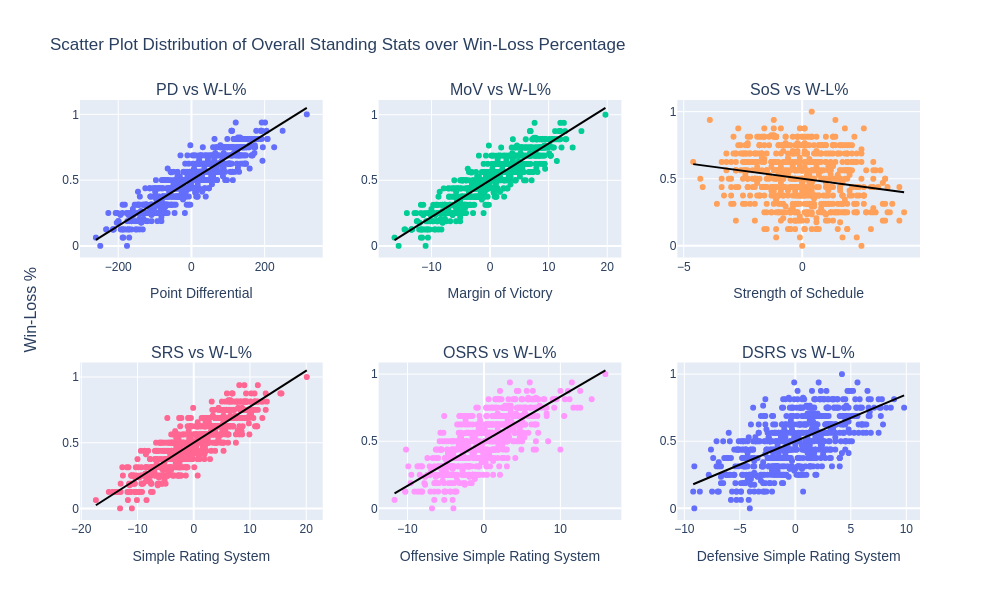

In [431]:
fig = plot_stats(standings_dict, 2, 3, 'Overall Standing Stats', 600, 1000)

fig.show()

From the graph, it appears that nearly all these stats, with the exception of `SoS`, follow a linear relationship, as evidenced by their r-squared values. These stats are actually the some of the strongest correlated with `W-L%`, as we'll see in a moment, so clearly these stats do a good job in predicting regular season success for a team. `SoS`, meanwhile, seems to have almost nothing to do with `W-L%`, which is fair [considering the methods for assessing it are flawed](https://theathletic.com/2585166/2021/05/13/nfl-strength-of-schedule-predicted-wins-vs-last-seasons-record-which-is-a-better-forecasting-method/).

One thing to note is that the r-squared values won't be very large for most of these statistics, as it's hard to properly fit these various values with a simple regression line. However, it's evident that most of these stats have a clear linear relationship with `W-L%` with all the data clustering around the trendlines, and that's really all we're looking for here. As such, any stats that have an r-squared value less than 0.1 will be dropped at the end, as we need at least 10% of the variation in the data to be explained by the linear model to meaningfully talk about a linear relationship.

Next, let's look at offensive passing stats. `offPass` will be broken up into 2 plots, one of which are general passing stats, and the other which comprises of passing completion stats. The first stat we'll be looking at are the general passing stats.

offPass Att r-squared value: 0.004366137926650526
offPass Yds/Att r-squared value: 0.29621559021889976
N Yds/Att r-squared value: 0.3721251367743045
offPass Pass Yds r-squared value: 0.09311056256394512
offPass TD r-squared value: 0.27727308719684773
offPass Rate r-squared value: 0.39061653022348597
offPass Sck r-squared value: 0.2225869048786956
offPass SckY r-squared value: 0.22480963407187593


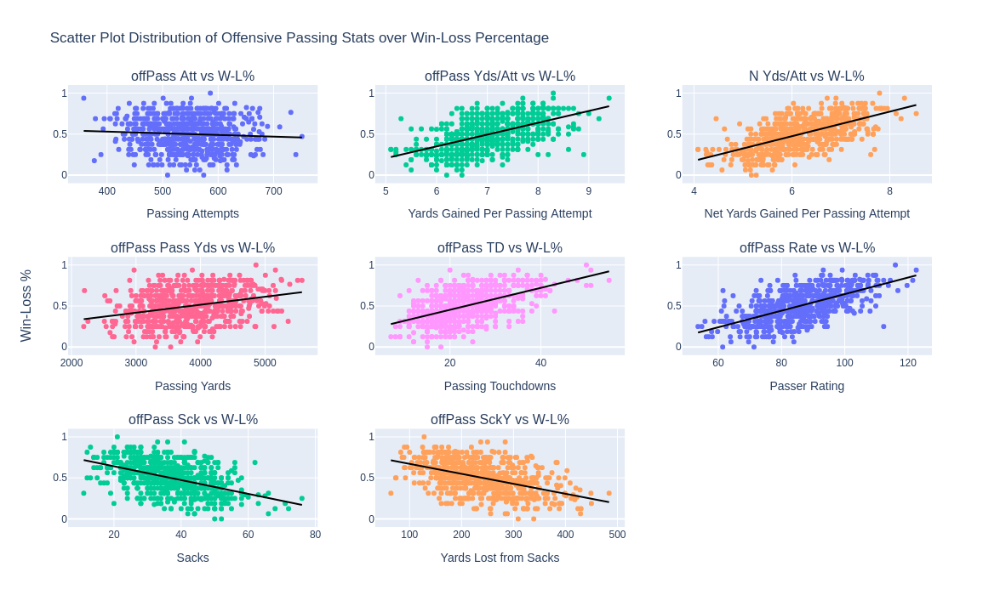

In [312]:
fig = plot_stats(off_pass_dict, 3, 3, 'Offensive Passing Stats', 700, 1175)

fig.show()

From the graph, we can see that the stats, with the exception of `offPass Att` and `offPass Pass Yds`, all follow a linear relationship, as evidenced by their r-squared values. `offPass Rate` seems to have the highest correlation with `W-L%` which makes sense, as this measures the QB's ability to throw the ball to the offense. Most people agree that [quarterback is the most important position in the game](https://bleacherreport.com/articles/1659834-power-ranking-the-importance-of-each-position-in-todays-nfl), so it makes sense that the better a QB performs, the higher a team's win-loss percentage would be.

Now, let's look at the other half of the `offPass` stats, those being the completion stats.

offPass Cmp r-squared value: 0.023447782103629078
offPass Cmp % r-squared value: 0.18769273252266594
offPass 1st r-squared value: 0.10785827463701492
offPass 1st% r-squared value: 0.33968359400803994
offPass 20+ r-squared value: 0.10182731860884042
offPass 40+ r-squared value: 0.09546390186057596
offPass Lng r-squared value: 0.007615171296141199


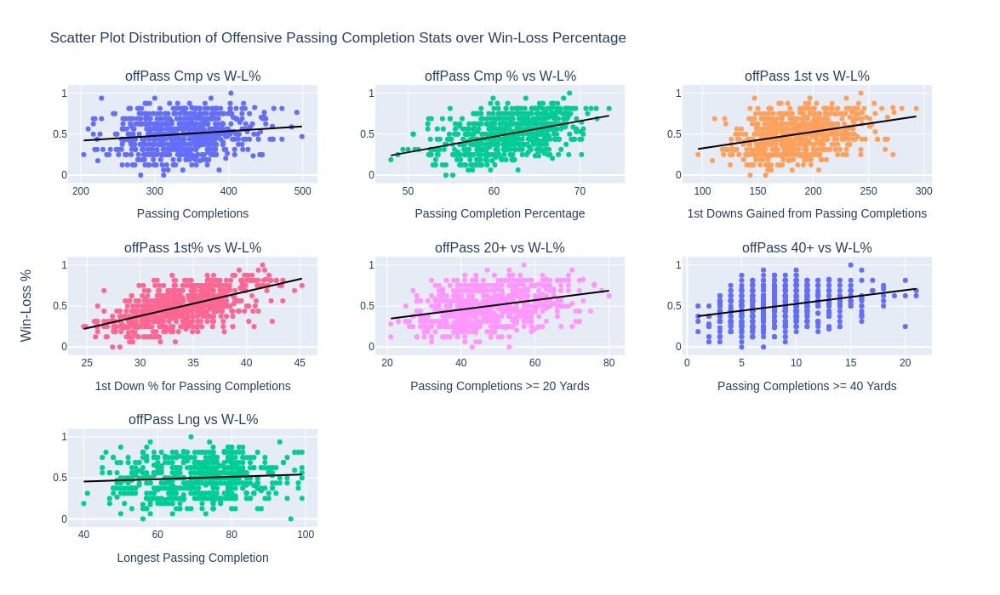

In [432]:
fig = plot_stats(off_comp_dict, 3, 3, 'Offensive Passing Completion Stats', 700, 1175)

fig.show()

From the graph, we can see that these stats aren't as highly correlated with `W-L%`, as evidenced by their r-squared values. The exception to this is `offPass 1st %`, which adds up, as getting more first downs gives offenses more opportunities to score. This stat is also [highly correlated with `N Yds/Att`](https://www.footballperspective.com/the-value-of-a-first-down/), so it's a highly valuable stat that is worth considering for our ML model.

Overall, the lower correlation numbers do make some amount of sense. Football isn't a pass-only sport, it also features a lot of rushing plays, which is what we'll look at for our next plot.

offRush Att r-squared value: 0.17935555180860507
offRush Rush Yds r-squared value: 0.11307438636327471
offRush YPC r-squared value: 0.013798571844611529
offRush TD r-squared value: 0.2266979522843413
offRush 20+ r-squared value: 0.04480478657713871
offRush 40+ r-squared value: 0.00959816179690498
offRush Lng r-squared value: 0.0006404931859592677
offRush Rush 1st r-squared value: 0.16253914592076268
offRush Rush 1st% r-squared value: 0.06678490664946368
offRush Rush FUM r-squared value: 0.030052252627693288


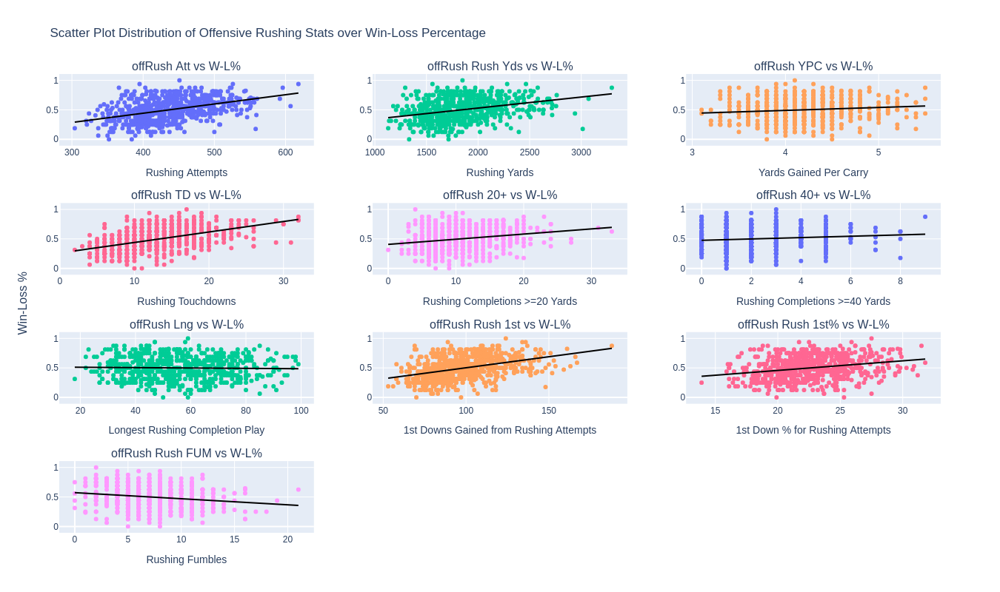

In [433]:
fig = plot_stats(off_rush_dict, 4, 3, 'Offensive Rushing Stats', 800, 1350)

fig.show()

Just like with the `offPass` stats, we can see that these stats aren't highly correlated with `W-L%`, as evidenced by their r-squared values. The two stats that stick out in this regard are `offRush TD` and `offRush YPC`. The former intuitively makes sense, as the more touchdowns you get, the better chance you have at accruing more points and therefore winning a game. The latter stat, however, is far more interesting. What this tells us is that offenses with a better, more efficient running game have a higher chance of scoring on each drive, leading to a higher win-loss percentage.

For our next plot, let's look at the offensive receiving stats.

offRec Rec r-squared value: 0.023457710540460086
offRec Yds r-squared value: 0.09314865858166044
offRec Yds/Rec r-squared value: 0.11544782093303574
offRec TD r-squared value: 0.27727308719684773
offRec 20+ r-squared value: 0.1025968453514966
offRec 40+ r-squared value: 0.09562158784274843
offRec Lng r-squared value: 0.007509187012124663
offRec Rec 1st r-squared value: 0.10779204544783028
offRec Rec 1st% r-squared value: 0.1899125840695124
offRec Rec FUM r-squared value: 3.5192395985816916e-05


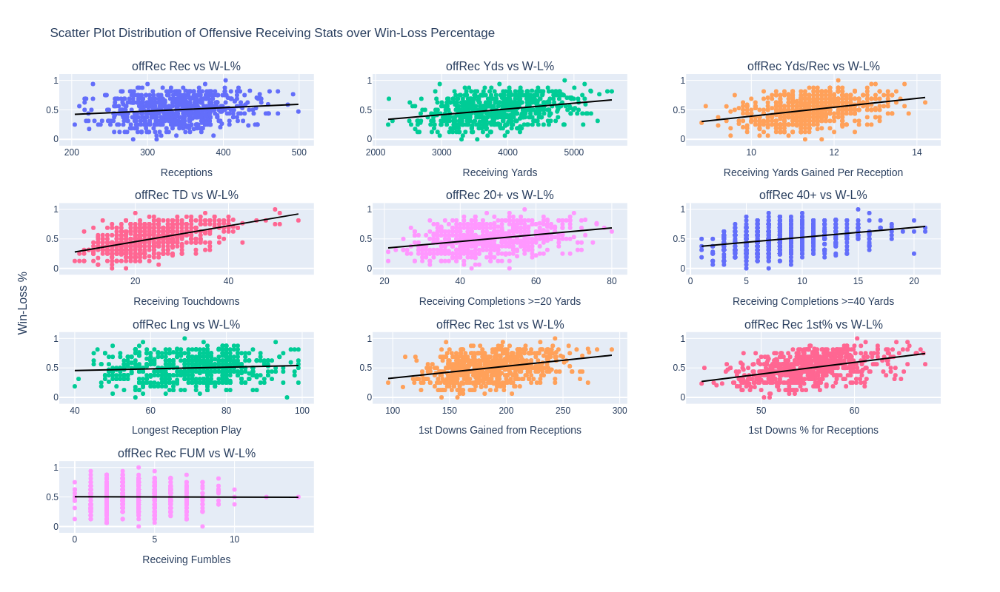

In [434]:
fig = plot_stats(off_rec_dict, 4, 3, 'Offensive Receiving Stats', 800, 1350)

fig.show()

Just like with the last couple graphs, we can see that these stats aren't highly correlated with `W-L%`, as evidenced by their r-squared values. The stats that stick out in this regard are `offRec TD`, `offRec Rec 1st%`, and `offRec Yds/Rec`. `offRec TD` is intuitive for reasons similar to `offRush TD`, so we won't discuss it. `offRec Yds/Rec` is in a similar situation to `offRush YPC`, although interestingly has a larger number of yards associated with it, [which can likely be explained by the fact that rushing yards start behind the line of scrimmage while receiving yards start from wherever the QB has thrown the ball from](https://www.ukgamblingsites.com/sports-betting/american-football/rushing-yards-passing-yards-receiving-yards-betting/). However, this leads to more 1st downs being recorded, which is what the last stat focuses on. This can also be explained similarly to the `offPass 1st%` stat.

Now, onto the offensive scoring stats.

offScor Tot TD r-squared value: 0.48640672416795994
offScor 2-PT r-squared value: 0.001290176163753487


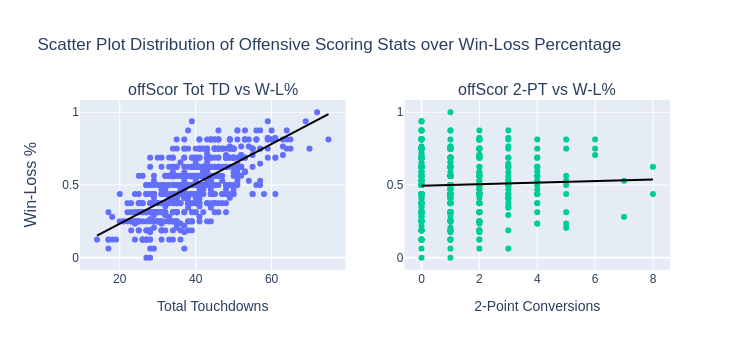

In [435]:
fig = plot_stats(off_scor_dict, 1, 2, 'Offensive Scoring Stats', 350, 750)

fig.show()

It's evident to see that `offScor 2-PT` is not at all correlated with `W-L%`, which is honestly a little surprising. I would've thought that netting 8 points from a touchdown, as opposed to 6 or 7, would increase the chance of a team winning. However, teams usually only go for 2 [when up by a lot or towards the end of a game when they're faced with a dire situation](https://www.sportingnews.com/us/nfl/news/nfl-2-point-conversion-success-rate/14xqvso7ght731i836opc1oxgz), so in this context it makes more sense. It's no suprise that `tot TD` are a good measurement of success for teams, and we've already discussed that at length.

Let's a look at offensive down stats.

offDown 3rd Att r-squared value: 0.030280839799291526
offDown 3rd Md r-squared value: 0.16665614553428332
offDown 4th Att r-squared value: 0.15693334079780918
offDown 4th Md r-squared value: 0.023877285160107342
offDown Scrm Plys r-squared value: 0.06316357345557211


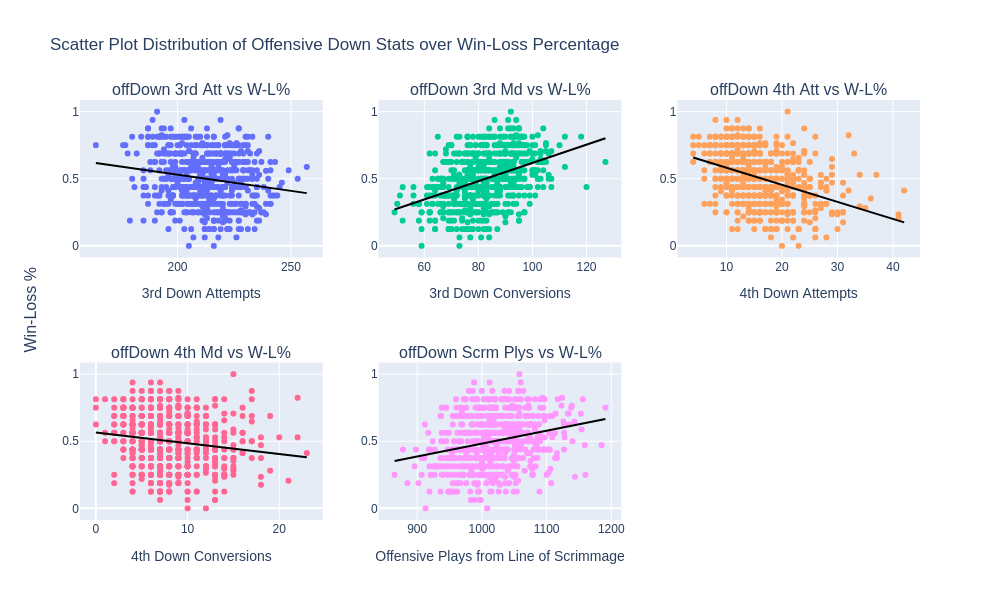

In [436]:
fig = plot_stats(off_down_dict, 2, 3, 'Offensive Down Stats', 600, 1000)

fig.show()

These stats are perhaps one of the more interesting ones we've seen thus far. `offDown 3rd Md` and `offDown 4th Att` are the only stats with significant correlations with `W-L%`. `offDown 4th Att` being negatively related to `W-L%` makes sense since if you haven't converted to a 1st down already, your offense probably isn't as good as it should be, and so therefore the other team will most likely win. On the contrary, converting many times on 3rd down gives your a team a good opportunity to score.

That's it for the offensive stats. Let's move on to the defensive ones.

defPass Att r-squared value: 0.1259787152766979
defPass Cmp r-squared value: 0.00922320513489494
defPass Cmp % r-squared value: 0.09094992799642121
defPass Yds r-squared value: 0.012165727634122603
defPass Yds/Att r-squared value: 0.22459438116239439
defPass TD r-squared value: 0.09983679094929754
defPass INT r-squared value: 0.18509585304933518
defPass 1st r-squared value: 0.0029879310671180326
defPass 1st% r-squared value: 0.1851283661674482
defPass Sck r-squared value: 0.16512819854091132


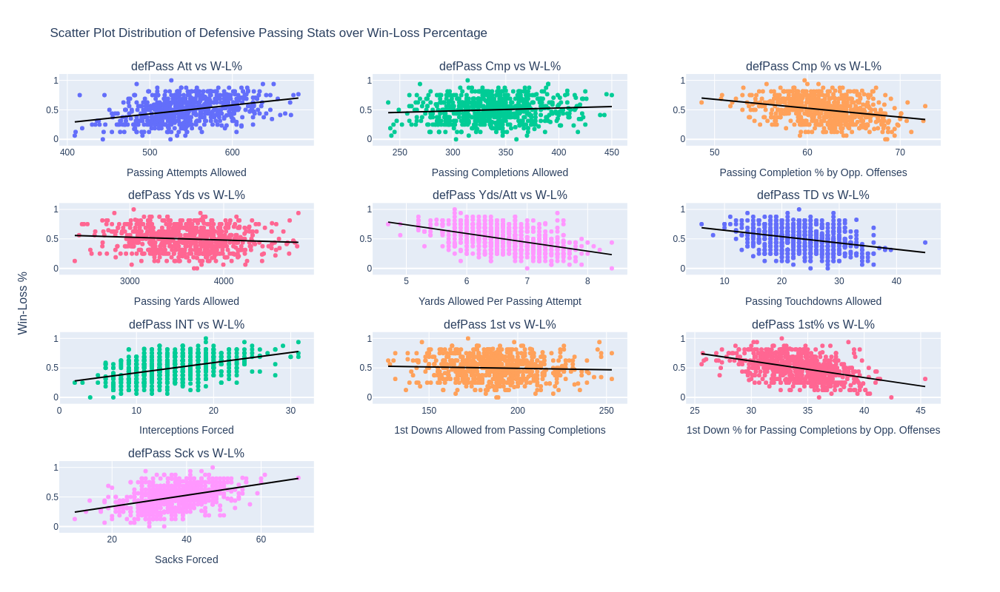

In [437]:
fig = plot_stats(def_pass_dict, 4, 3, 'Defensive Passing Stats', 800, 1350)

fig.show()

The four stats that have significant correlations are `defPass Att`, `defPass INT`, `defPass 1st%`, and `defPass Sck`. Up until this point, we were only focusing on the offensive side of things, so it's fitting that `defPass INT` and `defPass Sck` both measure how good a team's defense is. If the defense is able to force more turnovers, giving their offense a chance to score, it stands to reason that this would be a good measure for a team's win-loss percentage. `defPass 1st%` measures how good a defense is, and a defense that constantly allows opposing offenses to convert is likely not a team that will win very many games. `defPass Att` is kind of an anomaly here, as the amount of attempts that an offense attempts shouldn't really mean much in terms of win-loss percentage.

Let's now take a look at some defensive rushing stats.

defRush Att r-squared value: 0.41510439665542886
defRush Rush Yds r-squared value: 0.2299101620227917
defRush YPC r-squared value: 0.013862334660252995
defRush TD r-squared value: 0.19519711149220986
defRush Rush 1st r-squared value: 0.18435716501208188
defRush Rush 1st% r-squared value: 0.008380223480684679


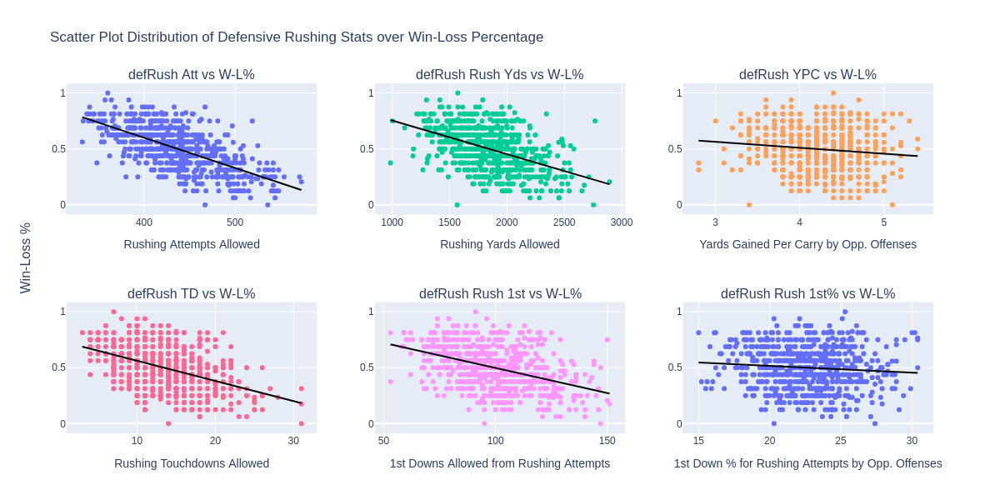

In [438]:
fig = plot_stats(def_rush_dict, 2, 3, 'Defensive Rushing Stats', 600, 1200)

fig.show()

Interestingly, this is the first graph in a while where all the stats are significantly correlated to `W-L%`. Intuitively, this makes sense, as the more times an opposing offense is able to rush on a defense, the weaker the defense is for the team facing against the opposing team, and a weaker defense leads to more points being scored on that team.

Now let's look at defensive scoring statistics.

defScor FR TD r-squared value: 0.008897507551635875
defScor SFTY r-squared value: 0.0016563020235650372
defScor INT TD r-squared value: 0.05320887229166116


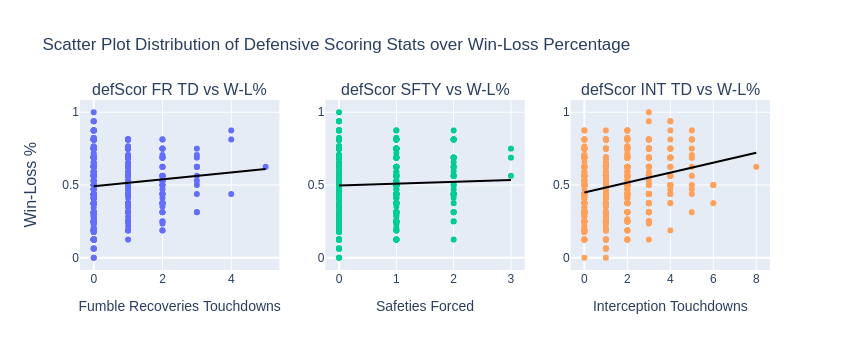

In [439]:
fig = plot_stats(def_scor_dict, 1, 3, 'Defensive Scoring Stats', 350, 850)

fig.show()

As we can see from the graph, none of these stats have any significant linear relationships with `W-L%`. Part of the reason for this is that [defensive scoring in general is quite rare](https://www.viqtorysports.com/what-is-a-safety-in-american-football-explained/), so there isn't enough data to draw from. There's also not that many of these plays that occur during a season, so most of the values are clustered between 0 and 2.

Hopefully the defensive downs stats will be more interesting.

defDown 3rd Att r-squared value: 0.003775937514040706
defDown 3rd Md r-squared value: 0.0881996157706636
defDown 4th Att r-squared value: 0.1884079241011879
defDown 4th Md r-squared value: 0.04411745341106055
defDown Scrm Plys r-squared value: 0.04579900369944234


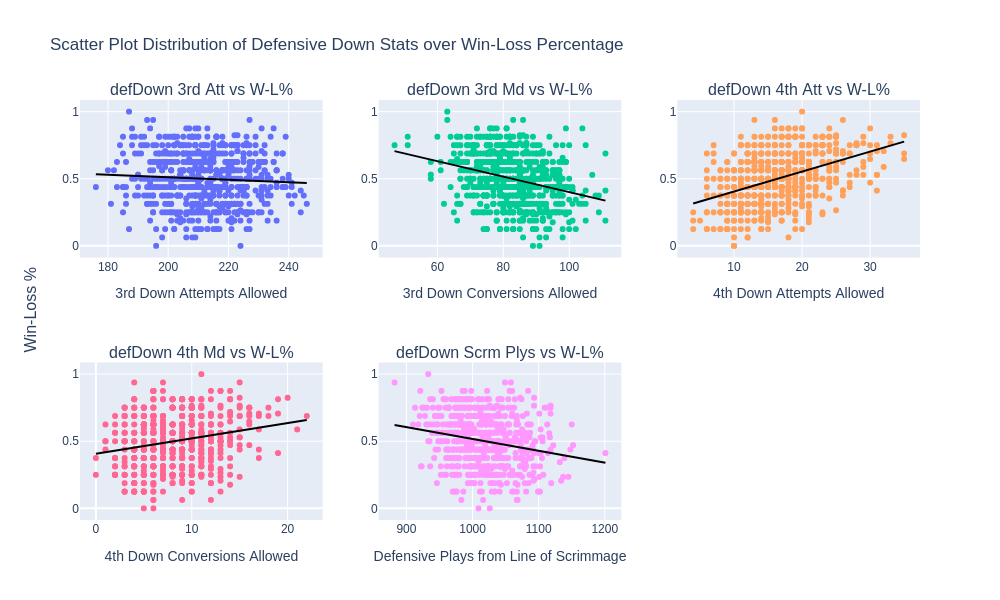

In [440]:
fig = plot_stats(def_down_dict, 2, 3, 'Defensive Down Stats', 600, 1000)

fig.show()

It turns out, not really. `defDown 4th Att` is the only significant stat here, and the reasoning is similar to the one given for `offDown 4th Att`, just in the other direction since we're dealing with defenses and not offenses.

Finally, let's have a look at defensive interception stats.

defInt INT Yds r-squared value: 0.0801502244788026
defInt Lng r-squared value: 0.01861704187458768
Turn Marg r-squared value: 0.2762835844736591


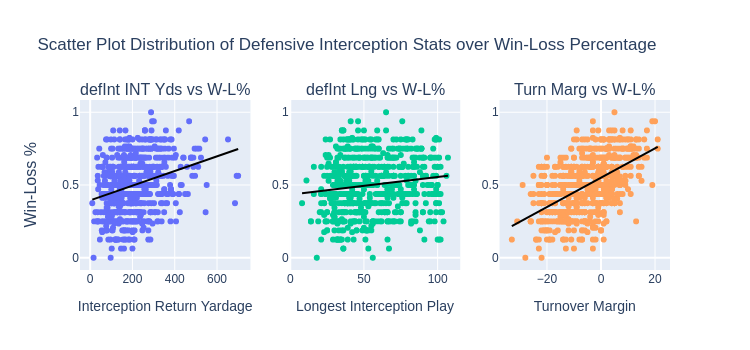

In [441]:
fig = plot_stats(def_int_dict, 1, 3, 'Defensive Interception Stats', 350, 750)

fig.show()

Once again, there's not much to show other than `Turn Marg`. A team's overall metric for turning the ball over is highly important for determining how well that team will fair in the regular season, since less turnovers means more chances for the team's offense to score. There are a few outliers which skews the regression line a bit, but overall, turnover margin and win-loss percentage is linearly related.

Now that we've looked at all the stats and determined which ones have the strongest linear correlations, we can drop the ones that don't and store this into `nfl_df_trim`.

In [442]:
# Drop any columns with r-squared val < 0.1
nfl_df_trim = nfl_df.drop(
    columns={'offPass Pass Yds',
            'offPass Cmp',
            'offPass 40+',
            'offPass Lng',
            'offRush 20+',
            'offRush 40+',
            'offRush Lng',
            'offRush Rush 1st%',
            'offRush Rush FUM',
            'offRec Yds',
            'offRec 40+',
            'offRec Lng',
            'offRec Rec FUM',
            'offScor 2-PT',
            'offDown 3rd Att',
            'offDown 4th Md',
            'offDown Scrm Plys',
            'defPass Cmp',
            'defPass Cmp %',
            'defPass Yds',
            'defPass TD',
            'defPass 1st',
            'defRush YPC',
            'defRush Rush 1st%',
            'defScor FR TD',
            'defScor SFTY',
            'defScor INT TD',
            'defDown 3rd Att',
            'defDown 3rd Md',
            'defDown 4th Md',
            'defDown Scrm Plys',
            'defInt INT Yds',
            'defInt Lng'
            })

nfl_df_trim

,Year,Team,W-L%,PD,MoV,SoS,SRS,OSRS,DSRS,Conference,...,offRec Yds/Rec,offRec TD,offRec 20+,offRec Rec 1st,offRec Rec 1st%,Won SB,Lost SB,Made SB,N Yds/Att,Turn Marg
0,2002,New York Jets,0.563,23,1.4,1.7,3.2,0.9,2.3,AFC,...,11.0,25,44,190,57.8,False,False,False,6.61,-2
1,2002,New England Patriots,0.563,35,2.2,1.8,4.0,2.1,1.9,AFC,...,10.1,28,37,184,49.2,False,False,False,5.62,-7
2,2002,Miami Dolphins,0.563,77,4.8,1.2,6.1,1.7,4.4,AFC,...,11.3,18,38,155,57.2,False,False,False,6.02,-10
3,2002,Buffalo Bills,0.500,-18,-1.1,0.9,-0.3,2.1,-2.3,AFC,...,11.6,24,45,218,57.8,False,False,False,5.99,-20
4,2002,Pittsburgh Steelers,0.656,45,2.8,-0.1,2.7,3.1,-0.4,AFC,...,11.5,26,51,199,56.9,False,False,False,6.55,-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,2022,Atlanta Falcons,0.412,-21,-1.2,-0.9,-2.1,-0.1,-2.0,NFC,...,11.4,17,37,148,57.6,False,False,False,5.97,-3
668,2022,San Francisco 49ers,0.765,173,10.2,-2.3,7.9,3.3,4.6,NFC,...,12.0,30,56,188,55.6,False,False,False,7.10,12
669,2022,Seattle Seahawks,0.529,6,0.4,-0.8,-0.5,1.9,-2.4,NFC,...,10.7,30,50,206,51.6,False,False,False,6.35,6
670,2022,Los Angeles Rams,0.294,-77,-4.5,0.5,-4.0,-4.1,0.0,NFC,...,10.0,16,37,180,52.0,False,False,False,5.26,1


### 4.3. <a id='toc4_3_'></a>[Analyzing playoff and Super Bowl teams](#toc0_)

#### 4.3.1. <a id='toc4_3_1_'></a>[Creating `sb_df`](#toc0_)

To best figure out which teams will have any sort of playoff success or any chance at the Super Bowl, we will find the average values for each stat and use these as a metric to filter out the teams with little to no chance at the playoffs.

Before that however, let's store this playoff-specific data into a new dataframe called `sb_df`, which will hold data on all teams that punched their ticket to the postseason in the last 21 years.

In [443]:
sb_df = nfl_df_trim.copy(deep=True)
sb_df = sb_df[sb_df['Made Playoffs']]
sb_df = sb_df.reset_index(drop=True)

sb_df

,Year,Team,W-L%,PD,MoV,SoS,SRS,OSRS,DSRS,Conference,...,offRec Yds/Rec,offRec TD,offRec 20+,offRec Rec 1st,offRec Rec 1st%,Won SB,Lost SB,Made SB,N Yds/Att,Turn Marg
0,2002,New York Jets,0.563,23,1.4,1.7,3.2,0.9,2.3,AFC,...,11.0,25,44,190,57.8,False,False,False,6.61,-2
1,2002,Pittsburgh Steelers,0.656,45,2.8,-0.1,2.7,3.1,-0.4,AFC,...,11.5,26,51,199,56.9,False,False,False,6.55,-15
2,2002,Cleveland Browns,0.563,24,1.5,-0.3,1.2,-0.4,1.7,AFC,...,10.8,27,47,171,50.6,False,False,False,5.81,-12
3,2002,Tennessee Titans,0.688,43,2.7,-0.9,1.8,1.6,0.1,AFC,...,11.2,22,35,182,59.5,False,False,False,6.37,-4
4,2002,Indianapolis Colts,0.625,36,2.3,-1.1,1.2,0.4,0.7,AFC,...,10.7,27,51,213,54.3,False,False,False,6.60,-21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
253,2022,New York Giants,0.559,-6,-0.4,0.0,-0.4,-0.8,0.4,NFC,...,9.9,17,28,170,49.1,False,False,False,5.54,6
254,2022,Minnesota Vikings,0.765,-3,-0.2,0.1,-0.1,2.8,-2.9,NFC,...,10.8,30,49,244,54.5,False,False,False,6.23,3
255,2022,Tampa Bay Buccaneers,0.471,-45,-2.6,0.4,-2.3,-3.3,1.1,NFC,...,9.5,26,49,240,48.1,False,False,False,5.93,2
256,2022,San Francisco 49ers,0.765,173,10.2,-2.3,7.9,3.3,4.6,NFC,...,12.0,30,56,188,55.6,False,False,False,7.10,12


#### 4.3.2. <a id='toc4_3_2_'></a>[Playoff teams visualizations](#toc0_)

Let's use `sb_df` to look at some of the stats surrounding teams that make the playoffs.

First, let's see the efficiency of each team that made the postseason. [We can calculate the efficiency](https://bestballstats.com/2021/01/08/nfl-offensive-and-defensive-ratings/) by plotting `DSRS` against `OSRS`. We''ll differentiate between Super Bowl winners and the rest. This will give us an idea as to how efficient each category was during the regular season.

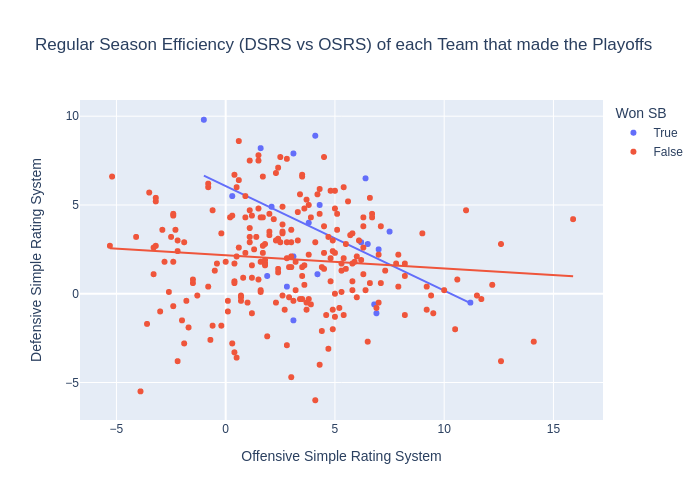

In [445]:
plot = px.scatter(sb_df, x='OSRS', y='DSRS',
                  color='Won SB',
                  # color_discrete_sequence=px.colors.qualitative.Pastel,
                  trendline='ols',
                  category_orders={'Won SB': [True, False]},
                  labels={
                    'OSRS': 'Offensive Simple Rating System',
                    'DSRS': 'Defensive Simple Rating System',
                  },
                  title='Regular Season Efficiency (DSRS vs OSRS) of each Team that made the Playoffs')

plot.show()

From the graph, we can see that the teams who won the Super Bowl generally have a higher efficiency than teams who didn't. In general, the higher your `DSRS` is for the regular season, the better your chances are at winning the Super Bowl. In general, teams with high `OSRS` don't perform as well during the Super Bowl, and this makes sense. There's a well-known saying in the NFL that [defense wins championships](https://bleacherreport.com/articles/1467101-does-defense-really-win-championships), and it appears the data agrees with that sentiment.

Now that we've looked at both types of postseason teams, let's take a moment to focus on just Super Bowl winners. What regular-season statistics make these teams perform so well? Let's start by reanalyzing efficiency (`DSRS` vs `OSRS`) in a [density map, also known as a heat map](https://chartio.com/learn/charts/heatmap-complete-guide/). The rectangles correspond to a range for each axis, and the number indicates how many teams meet both of these criteria. For instance, 1 Super Bowl-winning team had a `DSRS` between 9 and 10.9, and an `OSRS` between -2 and -0.1. Before we do this, we'll cast the `Won SB` and `Lost SB` variables as integers so that it works better in our heatmaps.

In [446]:
sb_df['Lost SB'] = sb_df['Lost SB'].astype(int)
sb_df['Won SB'] = sb_df['Won SB'].astype(int)

sb_df.head()

,Year,Team,W-L%,PD,MoV,SoS,SRS,OSRS,DSRS,Conference,...,offRec Yds/Rec,offRec TD,offRec 20+,offRec Rec 1st,offRec Rec 1st%,Won SB,Lost SB,Made SB,N Yds/Att,Turn Marg
0,2002,New York Jets,0.563,23,1.4,1.7,3.2,0.9,2.3,AFC,...,11.0,25,44,190,57.8,0,0,False,6.61,-2
1,2002,Pittsburgh Steelers,0.656,45,2.8,-0.1,2.7,3.1,-0.4,AFC,...,11.5,26,51,199,56.9,0,0,False,6.55,-15
2,2002,Cleveland Browns,0.563,24,1.5,-0.3,1.2,-0.4,1.7,AFC,...,10.8,27,47,171,50.6,0,0,False,5.81,-12
3,2002,Tennessee Titans,0.688,43,2.7,-0.9,1.8,1.6,0.1,AFC,...,11.2,22,35,182,59.5,0,0,False,6.37,-4
4,2002,Indianapolis Colts,0.625,36,2.3,-1.1,1.2,0.4,0.7,AFC,...,10.7,27,51,213,54.3,0,0,False,6.60,-21


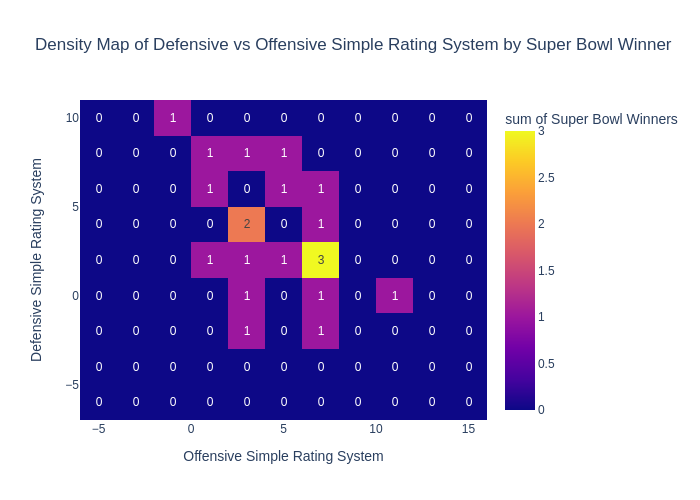

In [447]:
fig = px.density_heatmap(sb_df,
                         x='OSRS',
                         y='DSRS',
                         z='Won SB',
                         histfunc='sum',
                         text_auto=True,
                         labels={
                            'OSRS': 'Offensive Simple Rating System',
                            'DSRS': 'Defensive Simple Rating System',
                            'Won SB': 'Super Bowl Winners'
                         },
                         title='Density Map of Defensive vs Offensive Simple Rating System by Super Bowl Winner')

fig.show()

From this density map, it's clear to see that nearly every Super Bowl-winning team from 2002 onwards has had a non-negative `DSRS`, emphasizing the need for defense. However, all but one team have had non-negative `OSRS`s, highlighting that stat's importance as well. This goes to show that any team that wants a Lombardi must have a good offense and defense, which seems obvious.

However, as stated before, `DSRS` seems to be an important factor here, as the higher up the y-axis you go, the more Super Bowl-winning teams you see. Conversely, a higher `OSRS` doesn't necessarily translate to a Super Bowl-winning team's success.

Let's compare the rest of the playoff teams to the Super Bowl-winning teams, looking at the exact same graph.

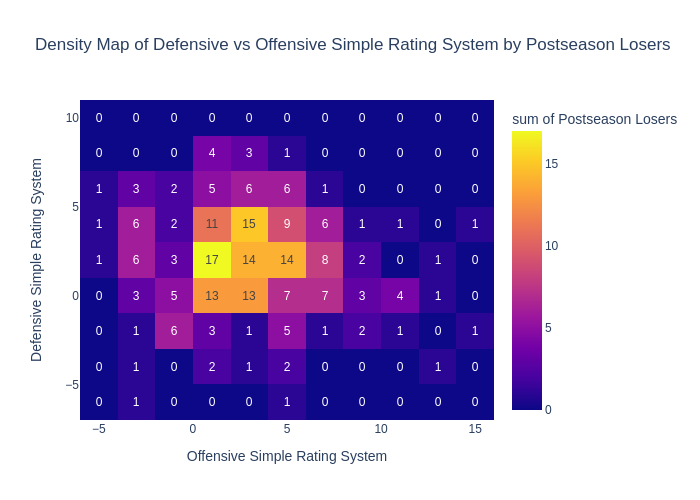

In [448]:
sb_df['Lost Post'] = sb_df['Won SB'].apply(lambda x: not x)
sb_df['Lost Post'] = sb_df['Lost Post'].astype(int)

fig = px.density_heatmap(sb_df,
                         x='OSRS',
                         y='DSRS',
                         z='Lost Post',
                         histfunc='sum',
                         text_auto=True,
                         labels={
                            'OSRS': 'Offensive Simple Rating System',
                            'DSRS': 'Defensive Simple Rating System',
                            'Lost Post': 'Postseason Losers'
                         },
                         title='Density Map of Defensive vs Offensive Simple Rating System by Postseason Losers')

fig.show()

From this density map, it appears that most postseason teams are concentrated between 0 and 5 `DSRS` and `OSRS`. There's also more of an emphasis on `OSRS` as opposed to `DSRS`, which, as we mentioned for Super Bowl-winning teams, doesn't necessarily translate to a Super Bowl-winning team's success. This shows why defense is king, as clearly all these playoff teams didn't stack up in the postseason. It also appears that Super Bowl-winning teams generally have better offenses than the rest of these playoff teams, which again, stresses the importance of being a well-balanced team.

#### 4.3.3. <a id='toc4_3_3_'></a>[Just the Super Bowl winners](#toc0_)

These next few graphs will be visualizing the stats of only the Super Bowl winners. Remember, this is our end goal, not just looking at playoff teams.

Now let's take a look at a Super Bowl-winning team's `Turn Marg` over their `MoV`. I decided to combine two stats that looked at overall margins (both offense- and defense-related) and plot them to see if there were any similarities.

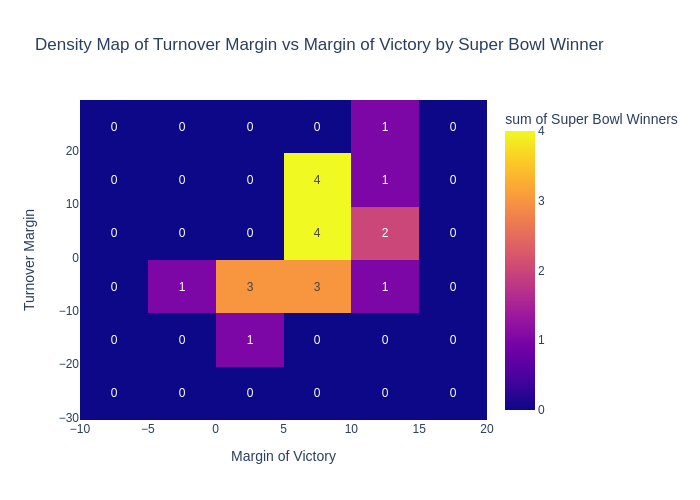

In [449]:
fig = px.density_heatmap(sb_df,
                         x='MoV',
                         y='Turn Marg',
                         z='Won SB',
                         histfunc='sum',
                         text_auto='.0f',
                         nbinsy=6,
                         labels={
                            'MoV': 'Margin of Victory',
                            'Turn Marg': 'Turnover Margin',
                            'Won SB': 'Super Bowl Winners'
                         },
                         title='Density Map of Turnover Margin vs Margin of Victory by Super Bowl Winner')

fig.show()

From the graph, it appears that nearly all Super Bowl-winning teams have both a non-negative turnover margin and margin of victory. This means, in general, that Super Bowl-winning teams win by a lot of points during the regular season. It also means that their defenses force a lot of turnovers and/or their offenses are highly efficient. This furthers the narrative that Super Bowl-winning teams are well-rounded teams, with superb offense and defense at their disposal.

Let's see how `SRS` stacks up against `W-L%`.

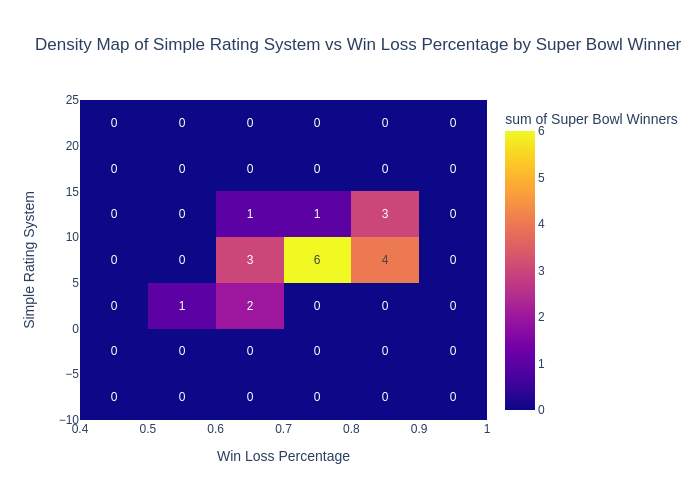

In [450]:
# fig = px.density_heatmap(sb_df, x='MoV', y='Turn Marg', z='W-L%', histfunc='avg', text_auto='.2f')
fig = px.density_heatmap(sb_df,
                         x='W-L%',
                         y='SRS',
                         z='Won SB',
                         histfunc='sum',
                         text_auto='.0f',
                         nbinsx=6,
                         labels={
                            'W-L%': 'Win Loss Percentage',
                            'SRS': 'Simple Rating System',
                            'Won SB': 'Super Bowl Winners'
                         },
                         title='Density Map of Simple Rating System vs Win Loss Percentage by Super Bowl Winner')

fig.show()

Something interesting to note is that every Super Bowl-winning team since 2002 has had an above average `SRS` (> 0) and a winning record above .500. The sweet spot appears to be an `SRS` between 5 and 10 and a win-loss percentage between 70 and 80%. In general, most Super Bowl winners have an `SRS` value above 5.

Our final visualization will be looking at the average number of receiving and rushing yards that Super Bowl winners produce during the regular season.

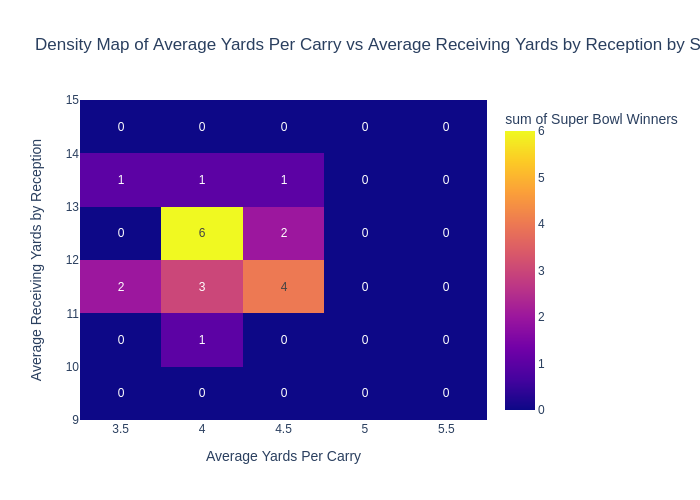

In [451]:
fig = px.density_heatmap(sb_df,
                         x='offRush YPC',
                         y='offRec Yds/Rec',
                         z='Won SB',
                         histfunc='sum',
                         text_auto='.0f',
                         nbinsy=6,
                         labels={
                            'offRush YPC': 'Average Yards Per Carry',
                            'offRec Yds/Rec': 'Average Receiving Yards by Reception',
                            'Won SB': 'Super Bowl Winners'
                         },
                         title='Density Map of Average Yards Per Carry vs Average Receiving Yards by Reception by Super Bowl Winner')

fig.show()

From the graph, we can see that most Super Bowl winners averaged a `YPC` above 3.8 and a `Yds/Rec` above 11, which actually isn't that far off from the average of all NFL teams. The mean for `YPC` is around 4.2 and the mean for `Yds/Rec` is around 11.4 (as we can calculate from the data), so actually the averages are higher than that of many Super Bowl-winning teams. Again, this emphasizes the need for defense, and shows that a team with an average offense with decent defense can make a serious run for the Lombardi.

## 5. <a id='toc5_'></a>[Modeling: Hypothesis Testing, Machine Learning, and Analysis](#toc0_)

### 5.1. <a id='toc5_1_'></a>[Defining the problem](#toc0_)

#### 5.1.1. <a id='toc5_1_1_'></a>[ML classification or regression?](#toc0_)

It's now time to perform machine learning. Before we do that, let's go over which variables we'll use to predict (`x`) and what we want to predict (`y`). We want to predict who the Super Bowl winner (`Won SB`) will be for the year given the team's regular season data (all standings and stats data). We will essentially be looking at each playoff team and judging whether or not they have what it takes to win the Super Bowl. Machine learning falls into two categories: classification and regression, and this problem is definitely an [ML classification problem](https://machinelearningmastery.com/types-of-classification-in-machine-learning/), as we will be classifying whether a team is of Super Bowl caliber.

#### 5.1.2. <a id='toc5_1_2_'></a>[Creating model input (`x`) and output (`y`)](#toc0_)

However, before we do this, we'll want to drop all values from 2022. This is because we want to train the model on the data leading up to the 2022 season, and then use the model to predict what it thinks the Super Bowl champion will be for the 2022 regular season. It would sort of defeat the purpose of machine learning if we kept the 2022 data as part of its training, so we'll split up `sb_df` into `past_df` and `curr_df`.

It would also defeat the purpose if we kept any information about how the postseason went (`Won SB`, `Lost SB`, `Made SB`, and `Lost Post`) in `x` since the model should be able to predict who would win the Super Bowl without knowing any additional information about the data. What I mean by this is that at the end of the regular season, you have no idea which teams will make the Super Bowl, much less win or lose it, so therefore those columns shouldn't be included in the first place. You do have information about if they `Made Playoffs`; however, all of these values will be True since this was the column we used when going from `nfl_df` to `sb_df`, so we can safely ignore it for our purposes.

In [333]:
past_df = sb_df[sb_df['Year'] != 2022]
curr_df = sb_df[sb_df['Year'] == 2022]

# Model expected output
y = past_df['Won SB']

# Model input: ignore all columns that give postseason info. `Made Playoffs` will be True for everything so we can also get rid of it
x = past_df.loc[:, ~past_df.columns.isin(['Won SB', 'Lost SB', 'Made SB', 'Lost Post', 'Made Playoffs'])]

x

,Year,Team,W-L%,PD,MoV,SoS,SRS,OSRS,DSRS,Conference,...,defFumb FR,defFumb FR TD,offRec Rec,offRec Yds/Rec,offRec TD,offRec 20+,offRec Rec 1st,offRec Rec 1st%,N Yds/Att,Turn Marg
0,2002,New York Jets,0.563,23,1.4,1.7,3.2,0.9,2.3,AFC,...,0,0,329,11.0,25,44,190,57.8,6.61,-2
1,2002,Pittsburgh Steelers,0.656,45,2.8,-0.1,2.7,3.1,-0.4,AFC,...,0,0,350,11.5,26,51,199,56.9,6.55,-15
2,2002,Cleveland Browns,0.563,24,1.5,-0.3,1.2,-0.4,1.7,AFC,...,0,0,338,10.8,27,47,171,50.6,5.81,-12
3,2002,Tennessee Titans,0.688,43,2.7,-0.9,1.8,1.6,0.1,AFC,...,0,0,306,11.2,22,35,182,59.5,6.37,-4
4,2002,Indianapolis Colts,0.625,36,2.3,-1.1,1.2,0.4,0.7,AFC,...,0,0,392,10.7,27,51,213,54.3,6.60,-21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239,2021,Green Bay Packers,0.765,79,4.6,-0.2,4.4,3.5,1.0,NFC,...,8,0,402,11.3,39,61,235,58.5,6.89,11
240,2021,Tampa Bay Buccaneers,0.765,158,9.3,-0.7,8.6,7.3,1.3,NFC,...,12,0,492,10.9,43,76,273,55.5,6.93,11
241,2021,Los Angeles Rams,0.706,88,5.2,0.1,5.3,4.2,1.1,NFC,...,6,0,406,12.0,41,65,233,57.4,7.27,3
242,2021,Arizona Cardinals,0.647,83,4.9,0.3,5.2,3.6,1.6,NFC,...,14,1,415,11.1,27,62,214,51.6,6.78,1


#### 5.1.3. <a id='toc5_1_3_'></a>[Separating numerical and categorical columns](#toc0_)

We will also break `x` up into categorical and numerical categories (named `x_categorical` and `x_numerical`, respectively).  This will be useful when we're preprocessing the data [in the next section](#toc5_2_). We'll also explain why `Year` is in `x_categorical` and not in `x_numerical` in the [One hot encoding section](#toc5_2_1_).

In [334]:
# Input broken up between categorical and numeric for preprocessing (numeric in next cell)
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
x_cat = x.select_dtypes(exclude=numerics)
x_cat.insert(0, 'Year', sb_df.Year)

x_cat

,Year,Team,Conference
0,2002,New York Jets,AFC
1,2002,Pittsburgh Steelers,AFC
2,2002,Cleveland Browns,AFC
3,2002,Tennessee Titans,AFC
4,2002,Indianapolis Colts,AFC
...,...,...,...
239,2021,Green Bay Packers,NFC
240,2021,Tampa Bay Buccaneers,NFC
241,2021,Los Angeles Rams,NFC
242,2021,Arizona Cardinals,NFC


In [335]:
x_num = x.select_dtypes(include=numerics)
x_num = x_num.drop(columns={'Year'})

x_num

,W-L%,PD,MoV,SoS,SRS,OSRS,DSRS,offPass Att,offPass Cmp %,offPass Yds/Att,...,defFumb FR,defFumb FR TD,offRec Rec,offRec Yds/Rec,offRec TD,offRec 20+,offRec Rec 1st,offRec Rec 1st%,N Yds/Att,Turn Marg
0,0.563,23,1.4,1.7,3.2,0.9,2.3,485,67.8,7.5,...,0,0,329,11.0,25,44,190,57.8,6.61,-2
1,0.656,45,2.8,-0.1,2.7,3.1,-0.4,551,63.5,7.3,...,0,0,350,11.5,26,51,199,56.9,6.55,-15
2,0.563,24,1.5,-0.3,1.2,-0.4,1.7,552,61.2,6.6,...,0,0,338,10.8,27,47,171,50.6,5.81,-12
3,0.688,43,2.7,-0.9,1.8,1.6,0.1,500,61.2,6.9,...,0,0,306,11.2,22,35,182,59.5,6.37,-4
4,0.625,36,2.3,-1.1,1.2,0.4,0.7,591,66.3,7.1,...,0,0,392,10.7,27,51,213,54.3,6.60,-21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239,0.765,79,4.6,-0.2,4.4,3.5,1.0,593,67.8,7.6,...,8,0,402,11.3,39,61,235,58.5,6.89,11
240,0.765,158,9.3,-0.7,8.6,7.3,1.3,731,67.3,7.4,...,12,0,492,10.9,43,76,273,55.5,6.93,11
241,0.706,88,5.2,0.1,5.3,4.2,1.1,607,66.9,8.1,...,6,0,406,12.0,41,65,233,57.4,7.27,3
242,0.647,83,4.9,0.3,5.2,3.6,1.6,591,70.2,7.8,...,14,1,415,11.1,27,62,214,51.6,6.78,1


#### 5.1.4. <a id='toc5_1_4_'></a>[80/20 training testing split](#toc0_)

We'll also split `x` and `y` into training and testing parts. We'll follow the [80/20 split](https://archive.is/MLSri), where 80% of the data is used for training and 20% is used for testing. We'll visit these later, once we've actually selected our models and are ready to begin testing and performing [hyper parameterization](https://machinelearningmastery.com/difference-between-a-parameter-and-a-hyperparameter/).

In [336]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

### 5.2. <a id='toc5_2_'></a>[Preprocessing](#toc0_)

[Data preprocessing](https://www.techtarget.com/searchdatamanagement/definition/data-preprocessing) is when we take raw data, and transform it such that it can be used in a machine learning model. We've actually already done most of the steps for it so far, which included tidying the data up (data wrangling; data transformation; data reduction, to an extent. see the [Dimensionality reduction section](#toc5_2_1_) for more info).

For preprocessing, we're going to want to streamline the process to make it easier for us as the coder to go through each step, and we can achieve this through [pipelining](https://scikit-learn.org/stable/modules/generated/sklearn.pipeline.Pipeline.html), which helps automate the preprocessing steps for us. Essentially, for each step we want to do in preprocessing, we'll pass said step into its own individual pipeline, and then pass all of pipelines together into one big pipeline that will run each step for us.

#### 5.2.1. <a id='toc5_2_1_'></a>[One hot encoding](#toc0_)

We've technically already partially [encoded](https://machinelearningmastery.com/one-hot-encoding-for-categorical-data/) some of the data in our dataframe when we converted `Won SB` and `Lost SB` from bools to ints; however, we're not using these values in the model so it doesn't really matter. We will also need to continue encoding for the other non-numeric categories like `Team` and `Conference`. `Year` will also be included in this category, as it is just a categorical value. A value of 2002 vs 2021 isn't going to impact the chance of a team's chance of making the Super Bowl. Thus, we'll include it here in the categorical values. This is also why we did included `Year` [in `x_cat` in the previous section](#toc5_1_3) when we were dividing the data up.

For this, we'll use what's known as [one hot encoding](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.OneHotEncoder.html), where we'll essentially create a column for each distinct value in `x` and number it 0 or 1 based on if the value matches. We then read the values of all the columns for those columns and turn it into a vector so that it can be displayed in just 1 column. For instance, `Conference` has 2 distinct values: AFC and NFC. AFC could be represented as <1, 0>, and NFC would then be represented as <0, 1>. I would have converted `Made Playoffs` into an integer value instead of encoding it, [as there doesn't appear to be a good reason to encode boolean values](https://datascience.stackexchange.com/questions/107470/converting-binary-valued-data-to-boolean-or-one-hot). There's some risk that it could lead to [overfitting](https://www.ibm.com/topics/overfitting), which would mean that given data outside of the data it was trained on, it would perform poorly. However, all the values would just be 1 (numerical representation of True) since this was the parameter we used to reduce `nfl_data` down to `sb_data`, which is why we didn't bother including it in the first place.

`cat_transformer` will hold this first part of the pipeline.

In [337]:
cat_transformer = Pipeline(
    steps=[("encoder", OneHotEncoder(handle_unknown='ignore'))]
)

#### 5.2.2. <a id='toc5_2_2_'></a>[Normalization](#toc0_)

For the numeric values, we will be scaling the variables to all be a similar range to one another. We'll do this to make sure that the different features all contribute equally to the model's output. For more information on normalization, [check out this article](https://www.analyticsvidhya.com/blog/2020/04/feature-scaling-machine-learning-normalization-standardization/). We'll figure out the optimal normalization when we're performing hyper parameterization.

In the meantime, here are some of the normalizations we can use to solve an ML classification problem:

- [Min-max normalization (feature scaling)](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html): data scaling technique that subtracts the minimum value from each feature and then divides the result by the range (max - min) of the feature. [Might be sensitive to outliers in the data](https://archive.is/Dnmzx)
- [Z-score normalization (standardization)](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html     ): scales the data to have a mean of 0 and a standard deviation of 1. Values get transformed to [z-scores](https://www.statisticshowto.com/probability-and-statistics/z-score/) (hence the name)
- [L2 normalization (least squares)](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.Normalizer.html#sklearn.preprocessing.Normalizer): scales the data such that the sum of the squared values ([Euclidean norm](https://mathworld.wolfram.com/EuclideanNorm.html)) of each column is 1 (each data point is divided by the Euclidean norm). [Prioritizes magnitude of the data](https://www.tutorialspoint.com/machine_learning_with_python/machine_learning_with_python_ltwo_normalization.htm)

For now, we won't pass in any of these values arbitrarily, as we'll find the one that best fits our model later. Therefore, we'll just default to a value of None. `num_transformer` will hold this part of the pipeline for us.

In [338]:
num_transformer = Pipeline(
    steps=[('scaler', None)]
)

scalers = [StandardScaler(), MinMaxScaler(), Normalizer()]

#### 5.2.3. <a id='toc5_2_3_'></a>[Using ColumnTransformer to combine both preprocessor steps](#toc0_)

Now, it's time to apply the different parts of the pipeline to their respective dataframes. In this case, the one hot encoding, represented by `cat_transformer`, will be performed on the categorical data (`x_cat`). The same logic holds for the normalization on the numerical data.

[ColumnTransformer](https://scikit-learn.org/stable/modules/generated/sklearn.compose.ColumnTransformer.html) allows for different columns to be transformed separately and combined into a single output array. In this case, it tranforms the categorical and numerical columns of x by whatever metric specified. We've defined these metrics in this section already, so it's just a matter of applying them to our dataframes of `x` from before. This will then be used as an input during feature selection and when training on the various ML models.

In [339]:
preprocesser = ColumnTransformer(
    transformers=[
        ('cat', cat_transformer, x_cat.columns),
        ('num', num_transformer, x_num.columns)
    ]
)

preprocesser_params = {'preprocess__num__scaler': scalers}

### 5.3. <a id='toc5_3_'></a>[Feature selection/dimensionality reduction](#toc0_)

Now that we've preprocessed our data, we can move on to the next steps, which includes feature selection.

Remember that in the exploratory data section, we trimmed the dataframe to only include stats that had an r-squared value above 0.1 with `W-L%` in an effort to filter out the most irrelevant stats. While we'll be analyzing the most likely Super Bowl winners, checking against `W-L%` is more useful a metric since that gave us a numeric value. In addition, the higher your `W-L%`, the better chances of you making the play-offs, and this is a pre-requisite to making the Super Bowl in the first place; in this way, we performed some manual [dimensionality reduction](https://machinelearningmastery.com/dimensionality-reduction-for-machine-learning/). We'll also let the model do that when it performs [feature selection](https://scikit-learn.org/stable/modules/feature_selection.html) via [SelectKBest](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.SelectKBest.html) and [f_classif](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.f_classif.html). f_classif computes the [ANOVA F-value](https://statisticsbyjim.com/anova/f-tests-anova/) between the target variable (`y`, which holds `Won SB`) and its features (all the values in `x`), which helps SelectKBest determine the top "K" features of the model.

In [340]:
feature_selector = SelectKBest(None)

feature_params = {
    "feature_selector__score_func": [f_classif, chi2, f_regression]
}

### 5.4. <a id='toc5_4_'></a>[Model selection, training, and evaluation](#toc0_)

#### 5.4.1. <a id='toc5_4_1_'></a>[Model selection](#toc0_)

Here's the classification models we'll be looking at for this project:

- [Logistic Regression](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html): a simple linear model that predicts the probability of a binary outcome
- [Decision Trees](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html): a model that learns simple decision rules from the data and creates a tree-like model of decisions and their possible consequences
- [Support Vector Machines (SVMs)](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html): a model that separates classes by finding the hyperplane that maximally separates the two classes

These were some of the more popular ones I found online. There might have been better ones that exist outside of these ones, but these were the ones that came up when I searched for it, so we're sticking with them in the hopes that they can perform better than a random guess.

I actually initially used many other models before, including [Random Forests](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html), [Naive Bayes](https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.MultinomialNB.html), [K-Nearest Neighbors (KNN)](https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html), [Gradient Boosting](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html), and [Multi-layer Perceptron (MLP)](https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPClassifier.html), but these all defaulted to assigning a value of 0 for `Win SB`, since that was the most optimal value to net the highest accuracy. I wanted to prioritize a value of 1 for `Win SB`, as that would actually give me a Super Bowl winner. Therefore, I came up with a dictionary `class_weights` that prioritized a Super Bowl winner 100 times more than a Super Bowl loser. I also had to cut the remaining models, as there was no easy way to integrate weights into their models, going from 8 models to 3. Still, this should be more than sufficient for our purposes. 

Let's initialize a dictionary called `models` that specifies each of the different models we'll be running and their various parameters which are passed in as lists to choose between a range of values.

In [ ]:
# Specifies how much weight to give to Win SB vs not
class_weight = [{0:1, 1:100}]

models = {
    'Logistic Regression': {
        'model': LogisticRegression(),
        'params': {
            # Specifies which algo to use for optimization
            'model__solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
            # Specifies type of regularization being used for regression
            'model__penalty': ['l1', 'l2', 'elasticnet', 'none'],
            # Specifies inverse of regularization strength (smaller = stronger)
            'model__C': [0.1, 1, 10, 100],
            # Specifies how much weight to give to Win SB vs not
            'model__class_weight': class_weight
        }
    },
    'Decision Trees': {
        'model': DecisionTreeClassifier(),
        'params': {
            # Specifies which function will measure the quality of a branching split
            'model__criterion': ['gini', 'entropy'],
            # Specifies max depth of decision tree
            'model__max_depth': [5, 10, 15, 20, 25],
            # Specifies min # of samples required to split internal node (2 means node will only be split if >=2 samples)
            'model__min_samples_split': [2, 5, 10],
            # Specifies min # of samples required to be at leaf node
            'model__min_samples_leaf': [1, 2, 4],
            # Specifies how much weight to give to Win SB vs not
            'model__class_weight': class_weight
        }
    },
    'Support Vector Machines (SVMs)': {
        'model': SVC(),
        'params': {
            # Specifies kernel type to be used in algo
            'model__kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
            # Specifies inverse of regularization strength (smaller = stronger)
            'model__C': [0.1, 1, 10, 100],
            # Specifies kernel coefficient
            'model__gamma': ['scale', 'auto'],
            # Specifies how much weight to give to Win SB vs not
            'model__class_weight': class_weight
        }
    }
}

#### 5.4.2. <a id='toc5_4_2_'></a>[Model training](#toc0_)

Now that we've defined everything that we need to build our pipelines, we can do this for each of the `model`s:

- Create a `pipeline` that has `preprocesser`, `feature_selection`, and the constructor of the model we want to run
- Create a [parameter grid](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.ParameterGrid.html) (`param_grid`) for each model that defines the hyper parameters that are to be tested for each feature passed in. This will help select the best possible features for each model to ensure it runs as best as it can. Here, we've run the model and tested it for hyper parameters at the same time
- See if the model currently exists. If it doesn't, we must:
  - Set up an [exhaustive grid search](https://towardsdatascience.com/grid-search-for-model-tuning-3319b259367e) via [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html). Taking in `pipeline` and `param_grid`, it will find every permutation of the hyper parameters specified. This will run 5 different times thanks to the [cross-validation](https://scikit-learn.org/stable/modules/cross_validation.html) scheme (`cv`) we passed in where the data will be split up 5 different ways. 4 of those folds will be used for training, while one of them is used for testing (same principle as 80/20 split). This helps prevents overfitting
  - Fit the grid search on our training data (`X_training`, `y_training`)
  - Save the fitted model in our Models directory as a .skops file, which is apparently [more secure than the default .pickle file](https://skops.readthedocs.io/en/stable/persistence.html).

In [ ]:
for (name, model) in models.items():
    
    print(f'~~~~~~~~ Looking at {name} ~~~~~~~~')

    # Create pipeline
    model['pipeline'] = Pipeline(
        steps=[
            ('preprocess', preprocesser),
            ('feature_selector', feature_selector),
            ('model', model['model'])
        ],
        memory='cache',
        verbose=True
    )

    # Build param grid
    model['param_grid'] = {**preprocesser_params, **feature_params, **model['params']}

    # Find path for model to load and save it
    rename = name.replace(' ', '')
    path = f'ML Models/{rename}.skops'

    # Run the models if model doesn't exist
    if not Path(path).exists():
        # Perform GridSearch to find hyperparameters
        model['grid_search'] = GridSearchCV(
            model['pipeline'],
            model['param_grid'],
            cv=5, n_jobs=-1
        )
        # Fit the data
        model['grid_search'].fit(X_train, y_train)

        # Save to files
        Path(path).parent.mkdir(parents=True, exist_ok=True)
        with open(path, "wb") as file:
            sio.dump(model['grid_search'], file)
            print(f'Saved fitted model to "{path}".')

    # File does exist, just load it up
    else:
        with open(path, "rb") as file:
            print("bruh")
            model['grid_search'] = sio.load(file=file, trusted=True)
            print(f'Loaded fitted model from "{path}".')

#### 5.4.3. <a id='toc5_4_3_'></a>[Model evaluation](#toc0_)

Classification models are different from linear regression models in that they don't use least squares regression to determine accuracy in the model. They use other measures, including (funnily enough), [accuracy](https://developers.google.com/machine-learning/crash-course/classification/accuracy), which is calculated by summing the true positives and negatives and dividing by the total number of points. Let's find the accuracy, [precision](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.precision_score.html) and [margin of error](https://www.statisticshowto.com/probability-and-statistics/statistics-definitions/margin-of-error/) for each of these models (MoE also depends on accuracy). Precision can be calculated by finding the true positives and dividing by the sum of the true and false positives. It's important that both accuracy and precision remain somewhat high, as [having one above the other is not ideal](https://towardsdatascience.com/accuracy-precision-recall-or-f1-331fb37c5cb9). With that in mind, let's see our results.

In [403]:
model_names = []
acc_arr = []
prec_arr = []

for (name, model) in models.items():
    # Add all names of the models
    model_names.append(name)
    
    # Look at test data and compare against actual output to determine accuracy
    y_pred = model['grid_search'].predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    acc_arr.append(accuracy)
    
    # Same thing but for precision
    precision = precision_score(y_test, y_pred)
    prec_arr.append(precision)

model_names_np = np.array(model_names)
acc_arr_np = np.array(acc_arr)
prec_arr_np = np.array(prec_arr)

n = len(model_names)
model_df = pd.DataFrame({
  'Model': pd.Series(model_names_np),
  'Accuracy': pd.Series(acc_arr_np),
  'Precision': pd.Series(prec_arr_np)
})

model_df['MoE'] = 1.96 * np.sqrt(model_df['Accuracy'] * (1 - model_df['Accuracy']) / n)

model_df

,Model,Accuracy,Precision,MoE
0,Logistic Regression,0.714286,0.375,0.511208
1,Decision Trees,0.795918,0.500,0.456070
2,Support Vector Machines (SVMs),0.795918,0.500,0.456070


From the dataframe, we can see that:
- Logistic Regression had around 71.43% accuracy and 37.5% precision
- Decision Trees had around 79.59% accuracy and 50.0% precision
- SVMs had around 79.59% accuracy and 50.0% precision

It seems that Decision Trees are tied for both the best accuracy AND precision, which is very interesting. Once we look at the actual generated results, however, it'll be clear which model is the better one (spoiler alert: NOT Decision Trees). On average, 79.6% of the values in the model will line up with the actual values, which I'm pretty happy with. On average, 50.0% of the positive values in the model (i.e. 1, meaning that team `Won SB`) will actually be positive as predicted by the model, which is not as good as accuracy, but it's what we've got, so we're rolling with it. MoE is also calculated using accuracy, so while it's worth calculating to see how far off some of the values are, the results we get will more or less be the same. The accuracy of Decision Trees and SVMs can vary by up to 0.456, which is high, but again, this was after we fitted the best hyperparameters possible, so we've done all we can for this.

#### 5.4.4. <a id='toc5_4_4_'></a>[Predicting the Super Bowl Winner for the 2022 Regular Season](#toc0_)

The time has finally come to put our model to the test. Here's where we'll see which team all our models have predicted to win the Super Bowl.

In [404]:
for name in models.keys():

    decision_tree = models[name]['grid_search']

    X_current = curr_df
    current_pred = X_current.copy()
    current_pred['Pred Won SB'] = decision_tree.predict(X_current)
    current_pred = current_pred[['Team', 'Conference', 'W-L%', 'SRS', 'Pred Won SB']]
    current_pred = current_pred.sort_values(by='Pred Won SB', ascending=False)
    current_pred = current_pred.reset_index(drop=True)

    print(f'~~~~~~~~ Now displaying {name} model ~~~~~~~~')
    display(current_pred)

~~~~~~~~ Now displaying Logistic Regression model ~~~~~~~~


,Team,Conference,W-L%,SRS,Pred Won SB
0,Miami Dolphins,AFC,0.529,1.8,1
1,Cincinnati Bengals,AFC,0.750,6.9,1
2,Los Angeles Chargers,AFC,0.588,-0.9,1
3,Dallas Cowboys,NFC,0.706,6.5,1
4,New York Giants,NFC,0.559,-0.4,1
5,Minnesota Vikings,NFC,0.765,-0.1,1
6,Tampa Bay Buccaneers,NFC,0.471,-2.3,1
7,Seattle Seahawks,NFC,0.529,-0.5,1
8,Buffalo Bills,AFC,0.813,10.9,0
9,Baltimore Ravens,AFC,0.588,3.1,0


~~~~~~~~ Now displaying Decision Trees model ~~~~~~~~


,Team,Conference,W-L%,SRS,Pred Won SB
0,Miami Dolphins,AFC,0.529,1.8,1
1,Cincinnati Bengals,AFC,0.750,6.9,1
2,Buffalo Bills,AFC,0.813,10.9,0
3,Baltimore Ravens,AFC,0.588,3.1,0
4,Jacksonville Jaguars,AFC,0.529,1.8,0
5,Kansas City Chiefs,AFC,0.824,6.2,0
6,Los Angeles Chargers,AFC,0.588,-0.9,0
7,Philadelphia Eagles,NFC,0.824,6.5,0
8,Dallas Cowboys,NFC,0.706,6.5,0
9,New York Giants,NFC,0.559,-0.4,0


~~~~~~~~ Now displaying Support Vector Machines (SVMs) model ~~~~~~~~


,Team,Conference,W-L%,SRS,Pred Won SB
0,Cincinnati Bengals,AFC,0.750,6.9,1
1,Jacksonville Jaguars,AFC,0.529,1.8,1
2,Dallas Cowboys,NFC,0.706,6.5,1
3,Buffalo Bills,AFC,0.813,10.9,0
4,Miami Dolphins,AFC,0.529,1.8,0
5,Baltimore Ravens,AFC,0.588,3.1,0
6,Kansas City Chiefs,AFC,0.824,6.2,0
7,Los Angeles Chargers,AFC,0.588,-0.9,0
8,Philadelphia Eagles,NFC,0.824,6.5,0
9,New York Giants,NFC,0.559,-0.4,0


Interestingly, all these models produced different results. First off, as you may have noticed, the models predicted more than 1 team to win the Super Bowl, which, for our purposes, is alright, since there will always be some false positives unfortunately. The models believe that each of these teams have a good shot at making and winning the Super Bowl, hence the reason multiple teams have been labeled. However, it also sorted these ranked teams from highest chance to worst within their own conferences, so we'll look at the top values for each conference and treat them as the teams that the model believes to have the best chance to at least make the Super Bowl. The top team is the one that the model truly believes has the best shot at winning the Super Bowl.

For Logistic Regression, the model believes that the Miami Dolphins and Dallas Cowboys have the best shot at making the Super Bowl, and that the Dolphins would come out on top.

For Decision Trees, it didn't consider any of the NFC teams to win the title, instead favoring the Miami Dolphins and Cincinnati Bengals, with the Dolphins being named as the model's best guess for the Super Bowl.


For SVMs, it narrowed down the pool to three teams, and it believes that Cincinnati Bengals and Dallas Cowboys have the best chance, with the Bengals [taking home their first Lombardi in franchise history](https://sports.betmgm.com/en/blog/nfl/how-many-times-cincinnati-bengals-super-bowl-appearances-bm03). Sorry Cowboys fans, looks like [it's still not your year](https://bleacherreport.com/articles/1683356-things-a-dallas-cowboys-fan-says).

Comparing the models against the actual outcome, where the Kansas City Chiefs [triumphed over](https://www.foxsports.com/nfl/super-bowl) the Philadelphia Eagles, it's surprising that neither of these teams were on any of the models. Then again, the teams chosen as the winners were pretty solid choices as [Dolphins' QB Tua Tagovailoa led all QBs in passing yards](https://www.thephinsider.com/2023/2/25/23614786/tagovailoas-successful-season-had-little-to-do-with-yards-after-the-catch); [the Bengals went on a 10-game tear](https://champsorchumps.us/team/nfl/cincinnati-bengals/longest-winning-streaks#:~:text=Cincinnati%20Bengals%20history%3F-,The%20longest%20winning%20streak%20including%20playoffs%20games%20in%20Cincinnati%20Bengals,to%20the%20Kansas%20City%20Chiefs.); and [the Cowboys improved their defense and efficiency across the board](https://cowboyswire.usatoday.com/lists/cowboys-2021-2022-comparison/), only losing some offensive capability because [starting QB Dak Prescott was injured for the first few games of the season](https://dknation.draftkings.com/nfl-injuries-fantasy/2022/9/11/23348377/dak-prescott-injury-updates-week-1-cowboys-vs-buccaneers-how-long-out-fantasy-football-depth-chart). It's also interesting that each model seemed to favor AFC teams over NFC teams, which can be interpreted as the model believes AFC teams are overall better and stronger than the NFC teams. This actually has some bearing, as many have pointed out that [the AFC is significantly more difficult than the NFC in terms of team rosters and QB play](https://fivethirtyeight.com/features/the-chalky-afc-is-stronger-than-the-schlocky-nfc/).

## 6. <a id='toc6_'></a>[Interpretation: Insight and Policy Decision](#toc0_)

We've made it to the end of the data science pipeline! Our goal was to determine what team would win the Super Bowl given their regular season data for that year. Let's look back at the process we took to get to this point:

- Data Collection: We collected data from 3 different sources. We collected 11 different regular season stats from NFL.com, 2 regular season conference standings from Pro-Football-Reference.com, and a list of all Super Bowl winners from Topend Sports
- Data Processing: We merged the stats and standings for each team in a year 21 times (from 2002 to 2022), and then merged that with the Super Bowl info. We then tidied the data, as well as dropped and added columns as needed for our use
- Exploratory Data Analysis and Visualization: We examined the strength of the linear relationship between win-loss percentage against the rest of the stats in the dataframe and dropped any stats that didn't have a high correlation. We also compared playoff teams that lost in the postseason with Super Bowl winners, and examined what range of stats Super Bowl winners wound up in using heatmaps
- Modeling - Hypothesis Testing, Machine Learning, and Analysis: We created ML pipelines (which included preprocessing and feature selection) using several different models, and fine-tuned the hyperparameters of the models as it was running via exhaustive grid-searching. We then compared each model against each other and used the best of the models to predict the Super Winner for the 2022 regular season

In the end, the best model ended up being both Decision Trees and SVMs, as they tied with an accuracy of 79.6%, which could vary by as much as 45.6%, and a precision of 50.0%. This meant that all their values ended up being 79.6% correct (accuracy), and that their labelings of Super Bowl winners were 50% correct (precision). They predicted the Miami Dolphins and the Cincinnati Bengals, respectively, to win the Super Bowl.

While my model may not have been the best, it is difficult to predict which teams will perform well in the regular season and Super Bowl season. Just take a look at [this prediction from CBS Sports' experts](https://www.cbssports.com/nfl/news/nfl-super-bowl-odds-2023-predictions-best-expert-picks-top-teams-to-target-from-football-insiders/), who picked the Buffalo Bills, Tampa Bay Buccaneers, and Green Bay Packers to win Super Bowl 57 ahead of the Kansas City Chiefs, [the eventual winner](https://www.foxsports.com/nfl/super-bowl). The Super Bowl runner-up, the Philadelphia Eagles, is nowhere to be found in the top 10 picks, despite them being one of the best teams in the league over the course of the regular season. My models didn't have them ranked highly either, which suggests that the Eagles likely far overperformed what they were expected to win. Sites like [538](https://projects.fivethirtyeight.com/2022-nfl-predictions/) do a better job at predicting these kinds of things, since they have access to much more data than us and use more weights and fields to predict their model. To see how their model progressed throughout the regular season, scroll down the page and click on "Forecast from" to see how their predictions changed over time.

However, I still had a lot of fun doing this project and trying to predict the Super Bowl winner from regular season data, and I hope you enjoyed reading as well! I'd love to retry this project again in the future, hopefully with more data as only being able to use data from 2002 onwards might have limited my model and overfit some of the data, and hopefully with higher accuracy and less variance. I might look into other ML models besides the ones I've already used in an effort to try and extrapolate better results, but again, that'll be a later issue. Besides that, I'm glad I got to explore the data science pipeline in a topic that I have a lot of interest in.